<a href="https://colab.research.google.com/github/AdhamSalih/DeepBallTAU/blob/master/ProjectDeepforBallDet_MF.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Project - Training Deep Network for ball detection with pytorch**
This Project includes training and evaluating a model for Ball Detection - with Multi-frame Relaxed data

# General setup

Mounting the drive

In [0]:
from google.colab import drive, files
drive.mount("/content/drive")
folderpath = '/content/drive/My Drive/Project_300746930_034915504/'


Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


Installing all the needed lib.

In [0]:
# !pip install torch numpy torchvision matplotlib tabulate
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader, TensorDataset
from torchvision import transforms, utils, datasets
import matplotlib.pyplot as plt
import numpy as np
from tabulate import tabulate
import pickle
import cv2


#Dataset Loading

In [0]:
idx = 0
train_batch = pickle.load( open( folderpath + "Dataset/Batches_500_cropped_small_images_1_pixel_mask_sequence_3_stuck/train/train_batch_file" + str(idx)+".h5", "rb" ) )
Images = train_batch[0]
Cin = Images.size()[1]
# print(Cin)
Labels = train_batch[1][:,0]
del train_batch
train_dataset = TensorDataset(Images,Labels)
del Images,Labels
while idx < 23:
  idx += 1
  train_batch = pickle.load( open( folderpath + "Dataset/Batches_500_cropped_small_images_1_pixel_mask_sequence_3_stuck/train/train_batch_file" + str(idx)+".h5", "rb" ) )
  # Images = torch.cat((Images,train_batch[0]))
  # Labels = torch.cat((Labels,train_batch[1][:,0]))
  Images = train_batch[0]
# Cin = Images.size()[1]
# print(Cin)
  Labels = train_batch[1][:,0]
  print(idx)
  del train_batch
  train_dataset1 = TensorDataset(Images,Labels)
  del Images,Labels
  train_dataset = torch.utils.data.ConcatDataset([train_dataset,train_dataset1])

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23


In [0]:
# train_dataset = torch.utils.data.ConcatDataset([train_dataset,train_dataset1])
batch_size = 50
train_dataloader = DataLoader(train_dataset,batch_size=batch_size,shuffle=True)
del train_dataset1
print(len(train_dataloader))

240


In [0]:
idx = 0
train_batch = pickle.load( open( folderpath + "Dataset/Batches_500_cropped_small_images_1_pixel_mask_sequence_3_stuck/test/test_batch_file" + str(idx)+".h5", "rb" ) )
Images = train_batch[0]
Labels = train_batch[1][:,0]
test_dataset = TensorDataset(Images,Labels)
while idx < 11:
  idx += 1
  train_batch = pickle.load( open( folderpath + "Dataset/Batches_500_cropped_small_images_1_pixel_mask_sequence_3_stuck/test/test_batch_file"+str(idx)+".h5", "rb" ) )
  # Images = torch.cat((Images,train_batch[0]))
  # Labels = torch.cat((Labels,train_batch[1][:,0]))
  Images = train_batch[0]
  Labels = train_batch[1][:,0]
  print(idx)
  del train_batch
  test_dataset1 = TensorDataset(Images,Labels)
  del Images,Labels
  test_dataset = torch.utils.data.ConcatDataset([test_dataset,test_dataset1])

1
2
3
4
5
6
7
8
9
10
11


In [0]:
# del train_batch
# test_dataset = TensorDataset(Images,Labels)
# del Images,Labels
test_dataloader = DataLoader(test_dataset,batch_size=batch_size,shuffle=True)
print(len(test_dataloader))

In [0]:
# uncomment for cross-validation

# test_idx = int(len(Images)*0.2)
# val_x, test_x = Images[:test_idx], Images[test_idx:]
# val_y, test_y = Labels[:test_idx], Labels[test_idx:]


# valid_dataset = TensorDataset(val_x,val_y)
# valid_dataloader = DataLoader(valid_dataset,batch_size=batch_size,shuffle=True)
# print(len(valid_dataloader))
# test_dataset = TensorDataset(test_x,test_y)
# test_dataloader = DataLoader(test_dataset,batch_size=batch_size,shuffle=True)
# print(len(test_dataloader))
# del Images,Labels

# MultiFrame-DeepBall

**Hyperparameters**

In [0]:


inital_lr = 0.001
SGDlr = 0.1
num_epochs = 75 #number of epochs 
toSGD = 1 # after num_epochs/toSGD switch to Adam 
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
if device != "cpu":
  print("GPU is available")
else:
  print("Work on CPU")
BN = True
DP = 0
WD = 0
clip = 0

GPU is available


*Network Classes and Training Functions* 


In [0]:
class DeepBallMF(nn.Module):
    def __init__(self, Cin):
        super(DeepBallMF, self).__init__()
        # the 1st conv. block 
        self.conv11 = nn.Conv2d(Cin, 8, 3,stride=2,padding=1)
        self.conv12 = nn.Conv2d(8, 8, 3,stride=1,padding=1) 
        
         # pooling size 2
        self.pool = nn.MaxPool2d(2, 2) 

        # the 2nd conv. block 
        self.conv21 = nn.Conv2d(8, 16, 3,padding=1)
        self.conv22 = nn.Conv2d(16, 16, 3,padding=1)
        
        # the 3rd conv. block 
        self.conv31 = nn.Conv2d(16, 32, 3,padding=1)
        self.conv32 = nn.Conv2d(32, 32, 3,padding=1)
        
        # the 4th conv. block 
        self.conv41 = nn.Conv2d(56, 56, 3,padding=1)
        self.conv42 = nn.Conv2d(56, 2, 3,padding=1)
        
        # Upsampling
        self.ups24 = nn.Upsample(scale_factor=2)
        self.ups34 = nn.Upsample(scale_factor=4)
        
        self.bn11 = nn.BatchNorm2d(8)
        self.bn12 = nn.BatchNorm2d(8)
        self.bn21 = nn.BatchNorm2d(16)
        self.bn22 = nn.BatchNorm2d(16)
        self.bn31 = nn.BatchNorm2d(32)
        self.bn32 = nn.BatchNorm2d(32)
        self.bn41 = nn.BatchNorm2d(56)
        self.bn42 = nn.BatchNorm2d(2)
        
    def forward(self, x):
      # 1st block
      if x.size()[2]!=272 or x.size()[3]!=480:
        x = F.interpolate(x, size=(272,480))
      
      x1 = F.relu(self.bn11(self.conv11(x)))
      x1 = F.relu(self.bn12(self.conv12(x1)))
      x1 = self.pool(x1)
      
      # 2nd Block
      x2 = F.relu(self.bn21(self.conv21(x1)))
      x2 = F.relu(self.bn22(self.conv22(x2)))
      x2 = self.pool(x2)
      
      # 3rd Block
      x3 = F.relu(self.bn31(self.conv31(x2)))
      x3 = F.relu(self.bn32(self.conv32(x3)))
      x3 = self.pool(x3)

      # 4th Block
      x2 = self.ups24(x2)
      x3 = self.ups34(x3)
      x4 = torch.cat([x2,x3,x1],dim=1)
      x4 = F.relu(self.bn41(self.conv41(x4)))
      x4 = F.relu(self.bn42(self.conv42(x4)))  
      
      out = F.log_softmax(x4,dim=1)
      if out.size()[2]!=68 or out.size()[3]!=120:
        out = F.interpolate(out, size=(68,120))
      del x1,x2,x3,x4
      torch.cuda.empty_cache()
      return out

In [0]:
def DeepBallLossMF(Pre,Tar,notlogflag = False):
  N_b = Tar.size()[0]
  Ballgt = Tar
  zer = torch.zeros_like(Ballgt)
  N = torch.sum(Ballgt,dim=(1,2)).int()+1
  BGgt = 1 - Tar

  M = torch.sum(BGgt,dim=(1,2)).int()+1
  if notlogflag:
    Pre = torch.log(Pre)
  Ballcm = Pre[:,0,:,:]
  BGcm = Pre[:,1,:,:]

  kernel = np.ones((3,3),np.uint8)
  errorSumPos = torch.zeros_like(N.double())
  for i in range(len(errorSumPos)):

    errorSumPos[i] = torch.sum(torch.mul(Ballcm[i].double(),Ballgt[i].double()))
  Lpos = torch.sum(torch.addcdiv(torch.zeros_like(N).double(),1,errorSumPos.double(),N.double()))
  errorSumNeg = torch.zeros_like(N.double())
  for i in range(len(errorSumNeg)):

    errorSumNeg[i] = torch.sum(torch.mul(BGcm[i].double(),BGgt[i].double()))
  Lneg = torch.sum(torch.addcdiv(torch.zeros_like(M).double(),1,errorSumNeg.double(),M.double()))


  del Ballgt,BGgt,Ballcm,BGcm
  torch.cuda.empty_cache()

  return -Lpos-1*Lneg


In [0]:
with torch.no_grad():
  model = DeepBallMF(Cin=Cin)
  model.eval()
  x = torch.randn([16,Cin,272,480])
  yt = torch.rand([16,68,120])
  yt = yt.int()
  print(x.size())
  y =  model(x)
  print(y.size())
  loss = DeepBallLossMF(y, yt)
  print(loss)
# del x, y, model,loss

torch.Size([16, 9, 272, 480])
torch.Size([16, 2, 68, 120])
tensor(11.4781, dtype=torch.float64)


Training function

In [0]:
def run_epochDeepBallMF(model, data,optimizer=False, is_train=False, clip=0):
  """Runs the model on the given data."""
  if is_train:
    model.train()
  else:
    model.eval()
  costs = 0.0
  iters = 0
  for iteration, (images, labels) in enumerate(data):
    images, labels = images.to(device), labels.to(device)
    model.zero_grad()
    output = model(images.float()/255.0)
    loss = DeepBallLossMF(output, labels) 
    costs += loss.item()
    iters += 1
    if is_train:
      loss.backward()
      if clip>0:
        nn.utils.clip_grad_norm_(model.parameters(), clip)
      optimizer.step()
  del loss
  return (costs / iters)

# ***Training MF-DeepBall***

++++++++++++++++++++++++++ Training ++++++++++++++++++++++++++
>> epoch: 1, train_loss: 18.783,  test_loss: 20.633
>> epoch: 2, train_loss: 16.936,  test_loss: 17.442
------------------ best model saved ---------------------------
>> epoch: 3, train_loss: 16.826,  test_loss: 22.576
>> epoch: 4, train_loss: 11.801,  test_loss: 11.437
------------------ best model saved ---------------------------
>> epoch: 5, train_loss: 12.384,  test_loss: 15.139
>> epoch: 6, train_loss: 9.555,  test_loss: 9.025
>> epoch: 7, train_loss: 8.209,  test_loss: 8.173
>> epoch: 8, train_loss: 7.519,  test_loss: 7.307
>> epoch: 9, train_loss: 6.332,  test_loss: 6.405
>> epoch: 10, train_loss: 5.863,  test_loss: 6.167
>> epoch: 11, train_loss: 5.141,  test_loss: 5.511
>> epoch: 12, train_loss: 4.805,  test_loss: 4.966
>> epoch: 13, train_loss: 4.471,  test_loss: 4.695
------------------ best model saved ---------------------------
>> epoch: 14, train_loss: 4.531,  test_loss: 4.991
>> epoch: 15, train_loss: 3.64

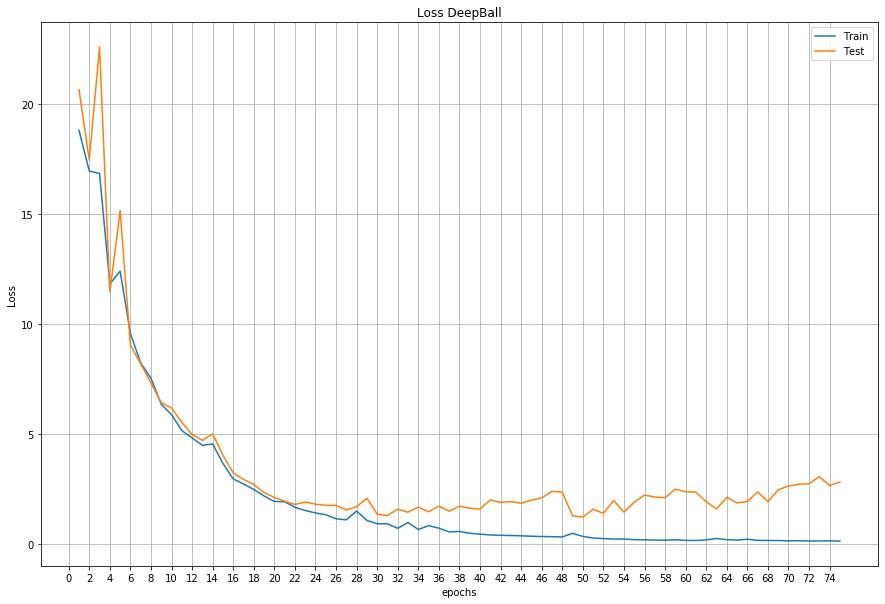

In [0]:
model = DeepBallMF(Cin).to(device)
# model.apply(weights_init)
model.to(device)
# optimizer = torch.optim.SGD(model.parameters(),lr = SGDlr,weight_decay=WD)
optimizer = torch.optim.Adam(model.parameters(),lr = inital_lr,weight_decay=WD)
scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=20, gamma=0.8)
ValidLoss = 10000000
flag = 0
cntr = 0
TrainP = []
ValidP = []
TestP = []
print("++++++++++++++++++++++++++ Training ++++++++++++++++++++++++++")
for epoch in range(num_epochs):
  if epoch == int(num_epochs/toSGD):
      print("++++++++++++++++++++++++++ Switching to Adam++++++++++++++++++++++++++")
      del optimizer
      optimizer = torch.optim.Adam(model.parameters(),lr = inital_lr)
  _ = run_epochDeepBallMF(model, train_dataloader,optimizer, True,clip)
  scheduler.step()
  with torch.no_grad():
    train_p = run_epochDeepBallMF(model, train_dataloader,optimizer, False) # presents without the dropout
    # valid_p = run_epoch(model, valid_dataloader,optimizer) # uncomment for cross-validation
    test_p = run_epochDeepBallMF(model, test_dataloader,optimizer)
  valid_p = test_p  # comment for cross-validation
 
  TrainP.append(train_p)
  ValidP.append(valid_p)
  TestP.append(test_p)
  if ValidLoss > valid_p:
    torch.save(model.state_dict(), folderpath+'DeepBallmodelMFa.pt')
    TrainLoss = train_p
    ValidLoss = valid_p
    TestLoss = test_p
    cntr = 0
    if flag == 1:
      flag = 0
  elif flag == 0:
    flag = 1
    print('------------------ best model saved ---------------------------')
  else:
    cntr += 1
    if cntr == int(num_epochs):
      num_epochs = epoch + 1
      print('-------------- over-training !!! Stop Training --------------------')
      break
    
  print('>> epoch: {}, train_loss: {:.3f},  test_loss: {:.3f}'.format(epoch+1, train_p,test_p))           

print("++++++++++++++++++++++++++ Done! ++++++++++++++++++++++++++")
plt.figure(figsize=(15,10))
plt.plot(range(1,num_epochs+1),TrainP, label = 'Train')
plt.plot(range(1,num_epochs+1),TestP, label = 'Test')
plt.xticks(np.arange(0, num_epochs+1, 2.0))
plt.ylabel('Loss')
plt.xlabel('epochs')
plt.legend()
plt.title('Loss DeepBall')
plt.grid(True)
plt.show()
DeepBallmodel = model
del ValidLoss, cntr, TrainP, ValidP, TestP
del model,optimizer

Random check

torch.Size([9, 272, 480])
torch.Size([3, 272, 480])
(2, 78) (3, 78) 0.9997072


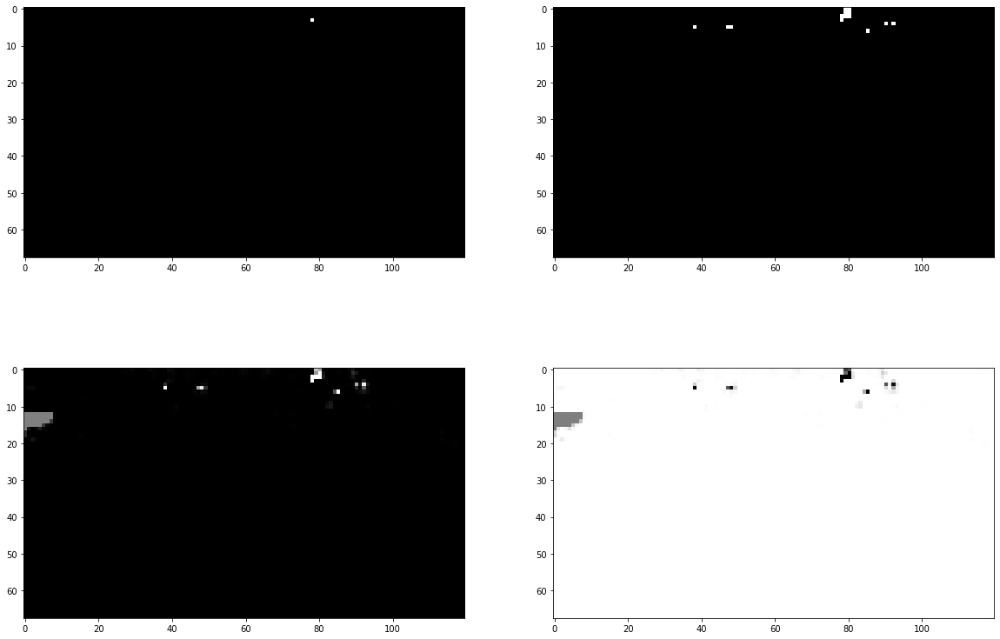

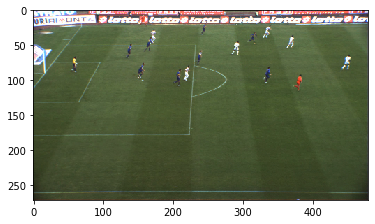

In [0]:

Cin = 9
DeepBallmodel = DeepBallMF(Cin).to(device)
DeepBallmodel.load_state_dict(torch.load(folderpath+'DeepBallmodelMFa.pt')) #load the last checkpoint
with torch.no_grad():
  DeepBallmodel.eval()
  index = 10
  img, label =  test_dataset[620]
  print(img.size())
  img1 = img[3:6]
  print(img1.size())
  # img, label = iter(dataloader).next()
  img = (img.view(1,9,272,480)).to(device)
  img1 = (img1.view(1,3,272,480)).to(device)
  Mask= DeepBallmodel(img.float()/255.0)
  Mask = torch.exp(Mask)
a = (Mask[0][0].cpu().numpy())
pos = np.unravel_index(np.argmax(a), a.shape)
real_pos = np.unravel_index(np.argmax(label.cpu().numpy()), label.cpu().numpy().shape)
print(pos, real_pos, a.max())

# print(label.size())
plt.figure(figsize=(20,14))
plt.subplot(2,2,1)
img1 = img1.to('cpu')
img1 = img1.view(3,272,480)
# plt.imshow(np.transpose(img.numpy(),(1,2,0)))
plt.imshow(label.cpu(),cmap='gray')
plt.subplot(2,2,2)
om = 1-torch.argmax(Mask.squeeze(), dim=0).detach().cpu().numpy()
Mask = Mask.cpu()
plt.imshow(om, cmap='gray')
plt.subplot(2,2,3)
plt.imshow(Mask[0][0], cmap='gray')
plt.subplot(2,2,4)
plt.imshow(Mask[0][1], cmap='gray')
plt.show()
plt.figure()
plt.imshow(np.transpose(img1.numpy(),(1,2,0)))
plt.show()

# Evaluate

In [0]:
def evaluate_pos(model,data,modeltype=2):
  model.eval()
  iteration = 0
  acc = 0
  # print(acc.sum())
  for i, (img, label) in enumerate(data):
    with torch.no_grad():
      Real_clas = np.max(label.cpu().numpy())>0
      real_pos = np.array(np.unravel_index(np.argmax(label.cpu().numpy(), axis=None), label.cpu().numpy().shape))
      img = (img.view(1,Cin,272,480)).to(device)
      if modeltype == 1:
        Mask, Cout= model(img.float()/255.0)
        Mask = torch.exp(Mask)
        a = Mask[0][0].cpu().numpy()
        pos = np.array(np.unravel_index(np.argmax(a, axis=None), a.shape))
        # p = a.max()*
        p = a.max()*Cout.cpu().numpy()
      else:
        Mask = model(img.float()/255.0)
        Mask = torch.exp(Mask)
        a = Mask[0][0].cpu().numpy()
        pos = np.array(np.unravel_index(np.argmax(a, axis=None), a.shape))
        p = a.max()
      # print(p, theta, pos,real_pos)
      
      if Real_clas:
        iteration += 1
        if np.max(np.abs(real_pos-pos)) < 5:
          acc += 1
  print('>> Acc: {:.3f}, with_ball  {}/{} '.format(acc/iteration*100, iteration,len(data)))  
  return acc/iteration

In [0]:
def evaluate(model,data):
  model.eval()
  Theta = []
  Acc = []
  theta = 0.94
  dtheta = 0.0005
  while theta < 1-0.0005 :
    
    theta = theta + dtheta
    acc = np.zeros(len(data), dtype=np.int16)
    # print(acc.sum())
    for i, (img, label) in enumerate(data):
      with torch.no_grad():
        Real_clas = np.max(label.cpu().numpy())>0
        real_pos = np.array(np.unravel_index(np.argmax(label.cpu().numpy(), axis=None), label.cpu().numpy().shape))
        img = (img.view(1,Cin,272,480)).to(device)
        Mask = model(img.float()/255.0)
        Mask = torch.exp(Mask)
        a = Mask[0][0].cpu().numpy()
        pos = np.array(np.unravel_index(np.argmax(a, axis=None), a.shape))
        p = a.max()
        # print(p, theta, pos,real_pos)
        if Real_clas:
          if (p>=theta) and np.max(np.abs(real_pos-pos)) < 5:
            acc[i] = 1
        else:
          if (p<theta):
            acc[i] = 1
    print(theta, acc.mean())
    
    Theta.append(theta)
    Acc.append(acc.mean())

  Acc = np.array(Acc)
  # print(Acc)
  # Theta = np.array(Thr)
  maxIdx = Acc.argmax()
  mTheta = Theta[maxIdx]
  mAcc = Acc.max()
  plt.figure(figsize=(15,10))
  plt.plot(Theta,Acc)
  plt.ylabel('Acc')
  plt.xlabel('theta')
  plt.grid(True)
  
  return mTheta, mAcc

In [0]:
# del train_dataset 
Cin = 9
DeepBallmodel = DeepBallMF(Cin).to(device)
DeepBallmodel.load_state_dict(torch.load(folderpath+'DeepBallmodelMF.pt')) #load the last checkpoint
mAcc = evaluate_pos(DeepBallmodel,test_dataset)

DeepBallmodel = DeepBallMF(Cin).to(device)
DeepBallmodel.load_state_dict(torch.load(folderpath+'DeepBallmodelMFa.pt')) #load the last checkpoint
mAcc = evaluate_pos(DeepBallmodel,test_dataset)

# plt.title('MF-DeepBall Model')
# plt.show()
# print(mAcc)

>> Acc: 82.425, with_ball  569/5986 
>> Acc: 73.814, with_ball  569/5986 


[  0. 344.] [0. 0.] 0.9814745


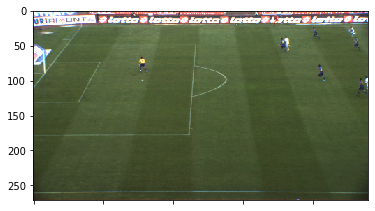

[ 12. 344.] [0. 0.] 0.9998789


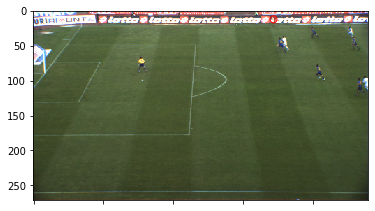

[ 16. 340.] [0. 0.] 0.99672997


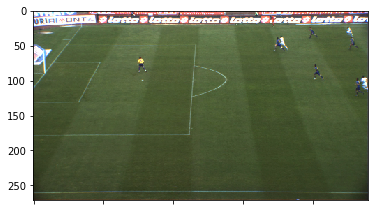

[ 12. 344.] [0. 0.] 0.9942677


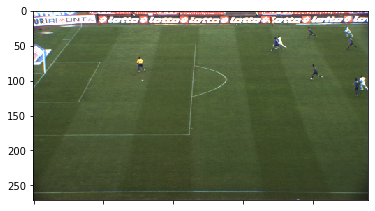

[ 56. 344.] [0. 0.] 0.9951253


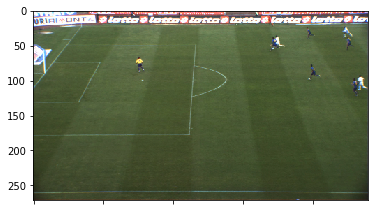

[ 28. 448.] [0. 0.] 0.99692625


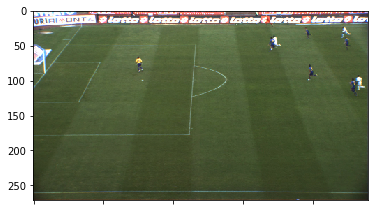

[ 28. 444.] [0. 0.] 0.99999046


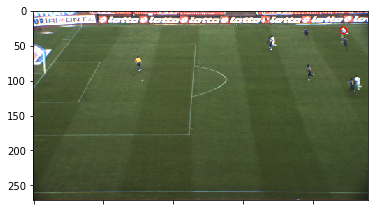

[ 32. 444.] [0. 0.] 0.97202843


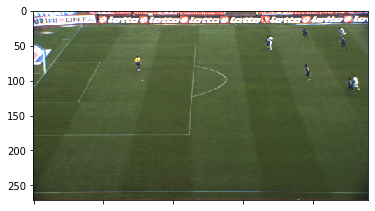

[ 40. 336.] [0. 0.] 0.99755675


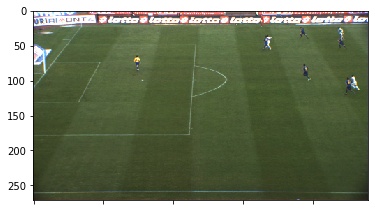

[ 48. 328.] [0. 0.] 0.9946143


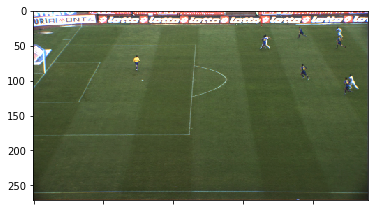

[ 52. 324.] [0. 0.] 0.9996124


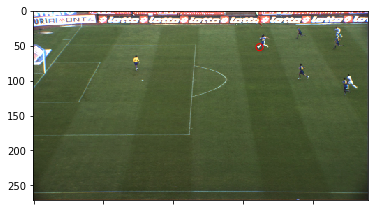

[ 52. 320.] [0. 0.] 0.99967766


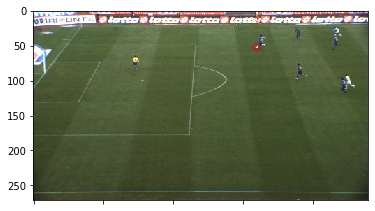

[ 52. 320.] [0. 0.] 0.9996334


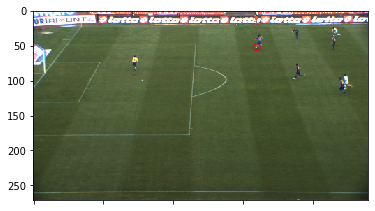

[ 32. 432.] [0. 0.] 0.9949786


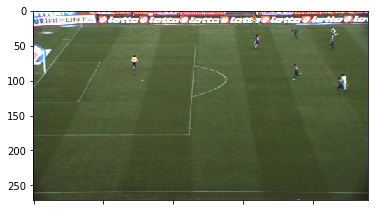

[ 12. 312.] [0. 0.] 0.9993398


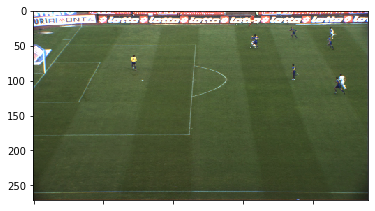

[ 48. 308.] [0. 0.] 0.99845195


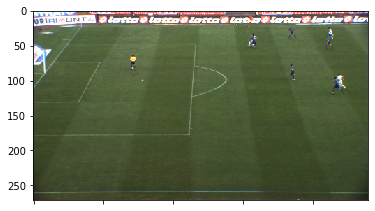

[ 48. 304.] [0. 0.] 0.9999942


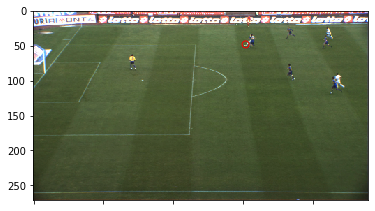

[ 52. 300.] [0. 0.] 0.9982153


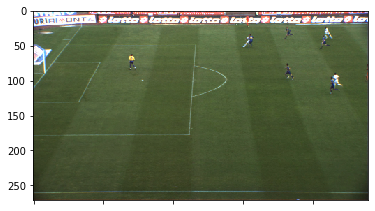

[ 40. 304.] [  4. 372.] 0.9950873


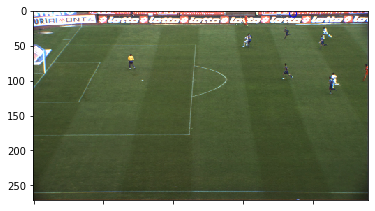

[ 48. 300.] [  4. 368.] 0.9997416


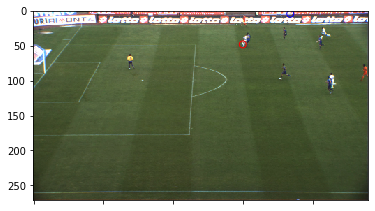

[ 48. 296.] [  8. 360.] 0.999093


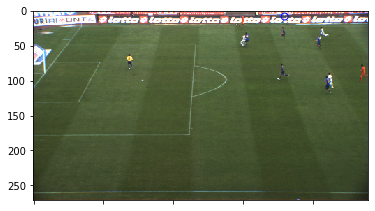

[  8. 352.] [  8. 356.] 0.9997473


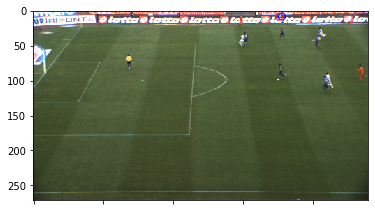

[ 36. 412.] [ 12. 348.] 0.9941876


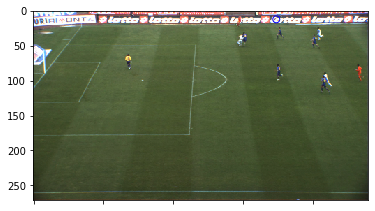

[ 40. 400.] [ 12. 340.] 0.98797077


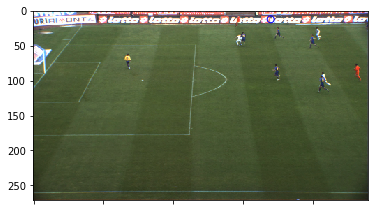

[104. 420.] [ 16. 328.] 0.997612


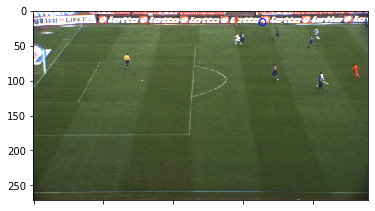

[ 20. 328.] [ 20. 328.] 0.9998989


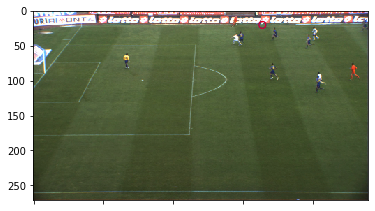

[ 20. 320.] [ 20. 320.] 0.99998564


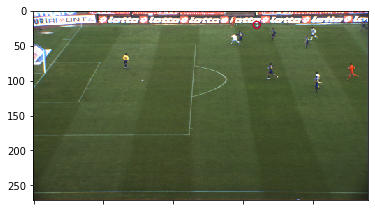

[ 24. 316.] [ 24. 316.] 0.99999803


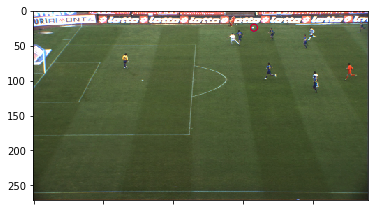

[ 28. 308.] [ 28. 308.] 1.0


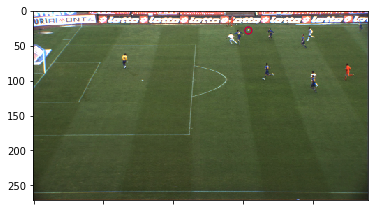

[104. 404.] [ 32. 304.] 0.9990411


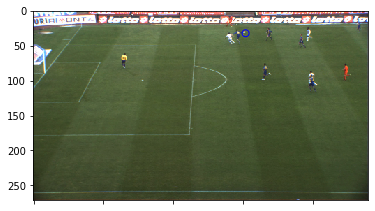

[104. 400.] [ 36. 296.] 0.9999199


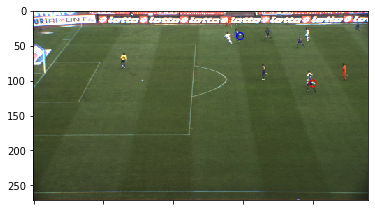

[ 36. 388.] [0. 0.] 0.94833934


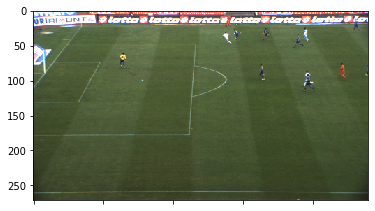

[ 44. 284.] [ 44. 284.] 0.99532604


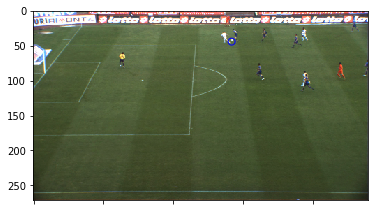

[ 44. 280.] [0. 0.] 0.9997301


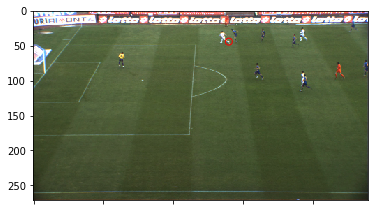

[ 96. 316.] [ 44. 276.] 0.98141766


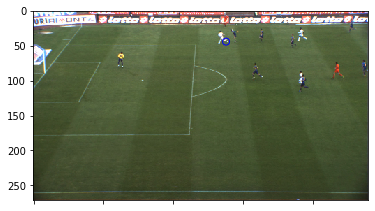

[ 96. 308.] [ 40. 272.] 0.9971602


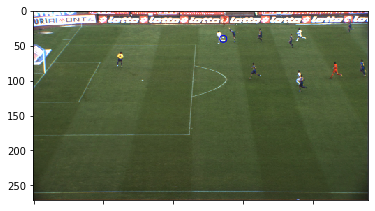

[ 92. 380.] [ 36. 268.] 0.9920712


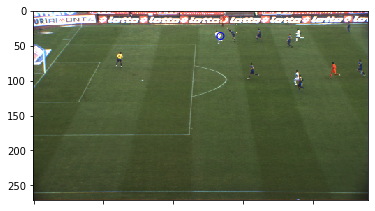

[ 92. 376.] [0. 0.] 0.9977114


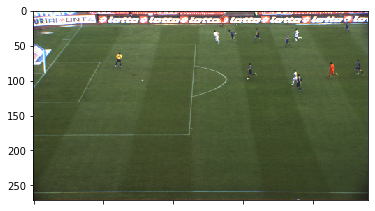

[ 40. 376.] [0. 0.] 0.9827994


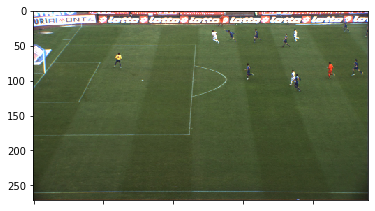

[ 16. 264.] [0. 0.] 0.99527144


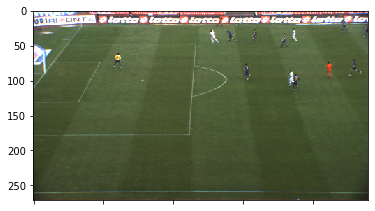

[ 40. 368.] [ 28. 252.] 0.9947899


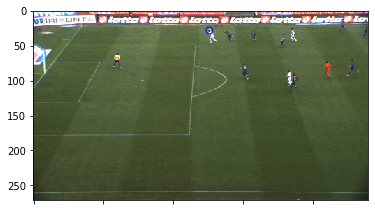

[ 40. 368.] [ 28. 252.] 0.98965734


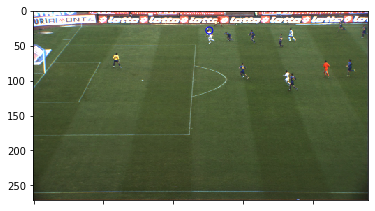

[ 24. 244.] [ 24. 248.] 0.99998665


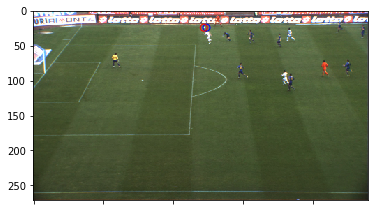

[ 24. 240.] [ 24. 244.] 0.9990477


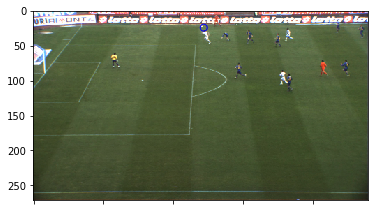

[ 24. 240.] [ 24. 240.] 0.9999772


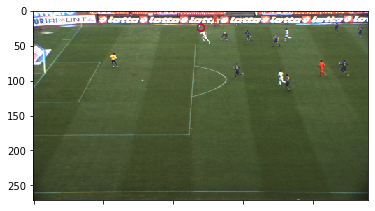

[ 20. 252.] [ 20. 236.] 0.99813116


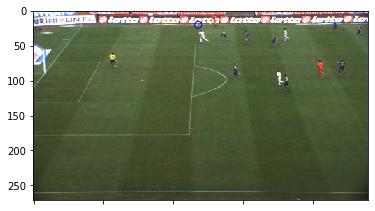

[ 20. 228.] [ 20. 232.] 0.9977557


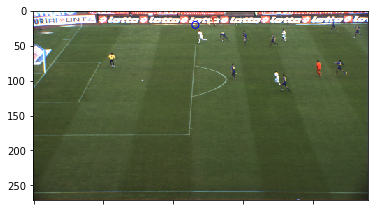

[ 20. 228.] [ 20. 228.] 0.9999104


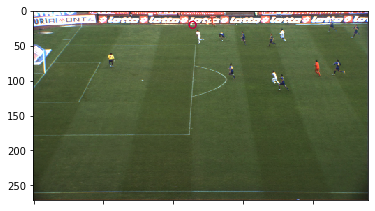

[ 20. 224.] [ 20. 224.] 0.9949986


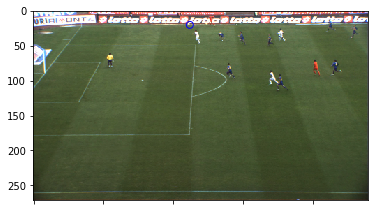

[ 20. 220.] [ 20. 220.] 0.9979841


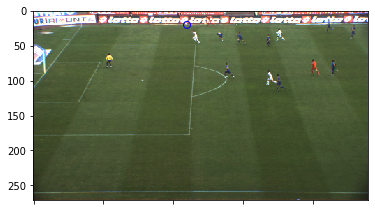

[ 20. 216.] [ 20. 216.] 0.9999333


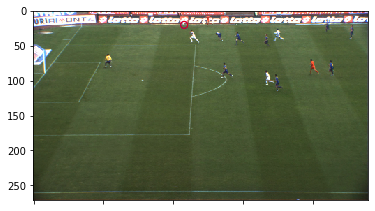

[ 20. 212.] [ 20. 212.] 0.9999361


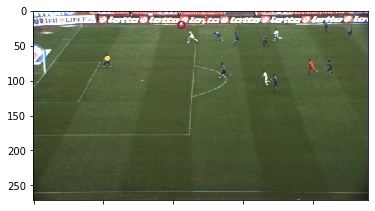

[ 20. 208.] [ 20. 208.] 0.9990949


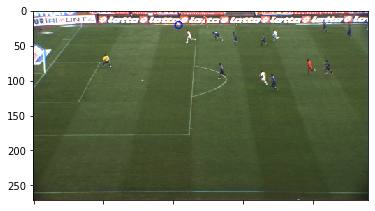

[ 20. 204.] [ 20. 204.] 0.99946654


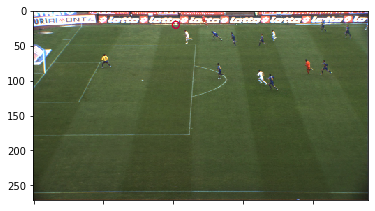

[ 20. 200.] [ 20. 200.] 0.9997301


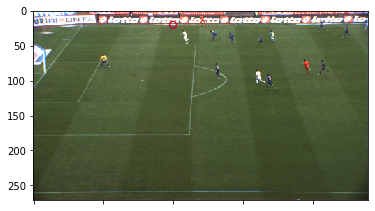

[ 20. 196.] [ 20. 196.] 0.99947566


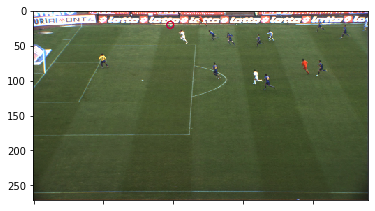

[ 24. 192.] [ 24. 196.] 1.0


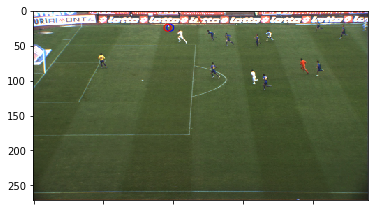

[ 24. 192.] [ 24. 192.] 0.99999714


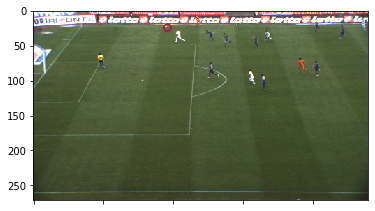

[ 24. 188.] [ 24. 188.] 1.0


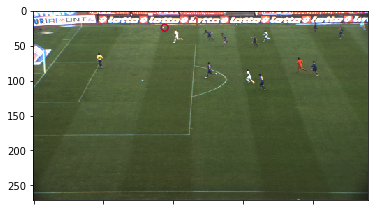

[ 24. 184.] [ 28. 184.] 1.0


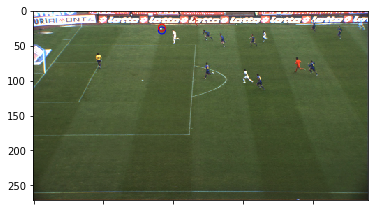

[ 28. 180.] [ 28. 180.] 1.0


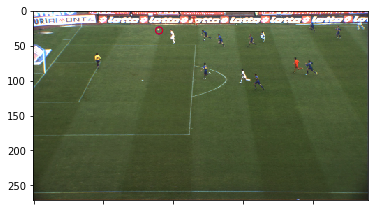

[ 28. 176.] [ 32. 176.] 0.9999333


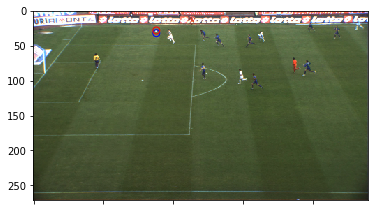

[ 32. 172.] [ 32. 172.] 0.99999046


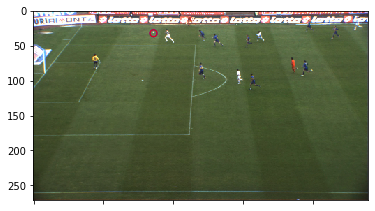

[ 32. 168.] [ 36. 168.] 1.0


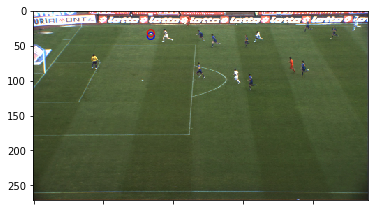

[ 36. 164.] [ 36. 164.] 1.0


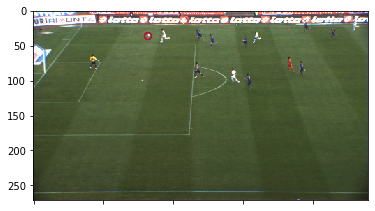

[ 40. 160.] [ 40. 164.] 0.9999924


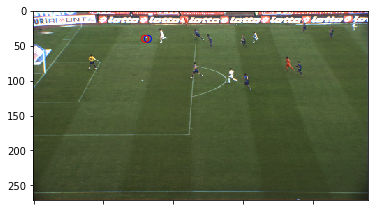

[ 40. 160.] [ 40. 160.] 0.99999803


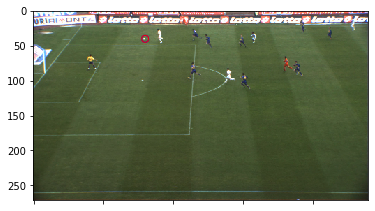

[ 44. 156.] [ 44. 156.] 1.0


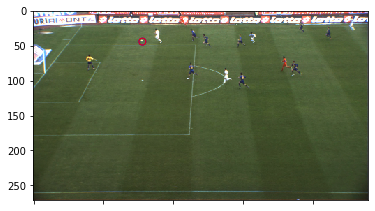

[ 40. 152.] [ 44. 152.] 0.9999961


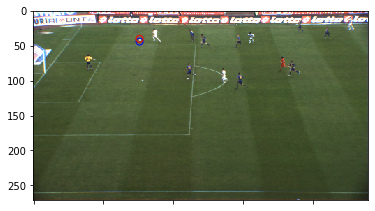

[ 40. 152.] [ 40. 152.] 0.9999667


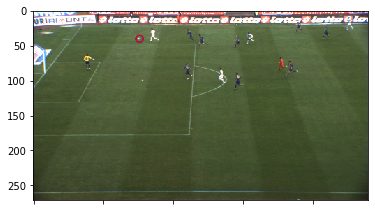

[ 40. 148.] [ 40. 148.] 0.9998865


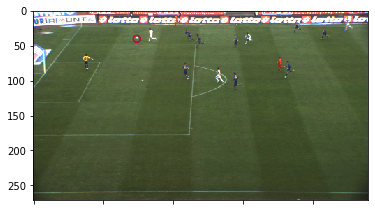

[ 40. 148.] [ 36. 148.] 0.99996084


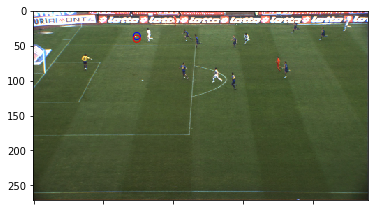

[ 36. 144.] [ 36. 144.] 0.99999905


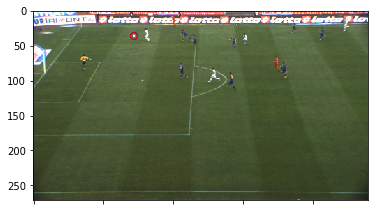

[ 36. 144.] [ 36. 144.] 0.9998026


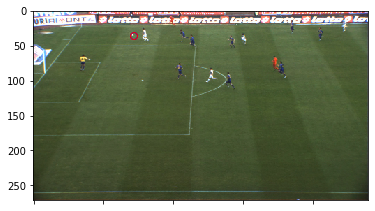

[ 36. 140.] [ 36. 140.] 0.9999075


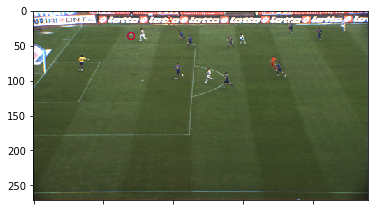

[ 40. 296.] [ 36. 140.] 0.99997514


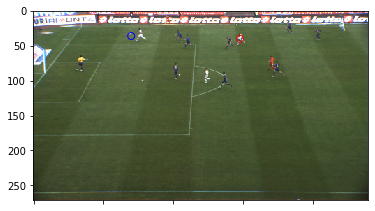

[ 32. 136.] [ 32. 136.] 0.99979407


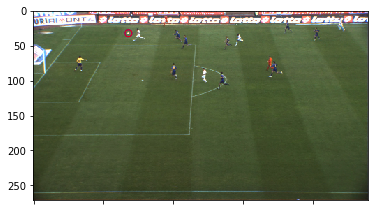

[ 88. 244.] [ 32. 136.] 0.99964577


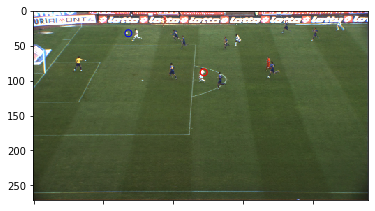

[ 88. 240.] [ 32. 132.] 0.99984837


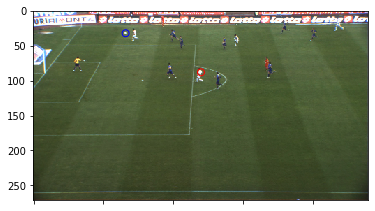

[ 44. 288.] [ 32. 132.] 0.99996465


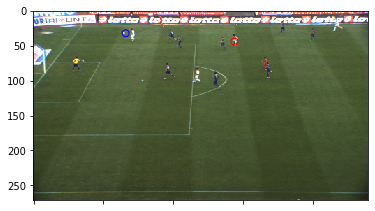

[ 88. 232.] [ 32. 128.] 0.99999905


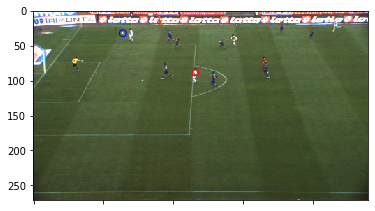

[ 32. 124.] [ 32. 128.] 0.9997215


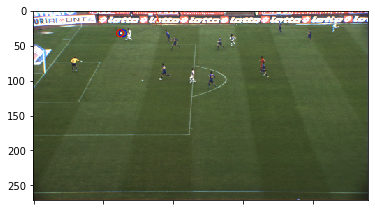

[ 32. 124.] [ 32. 124.] 0.99948275


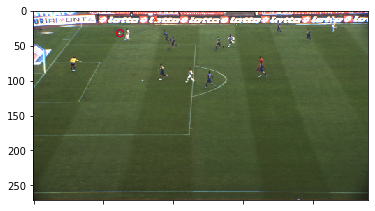

[ 48. 280.] [ 36. 120.] 0.9996663


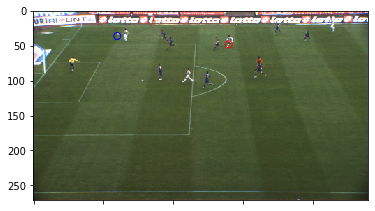

[ 36. 120.] [ 36. 120.] 0.9999772


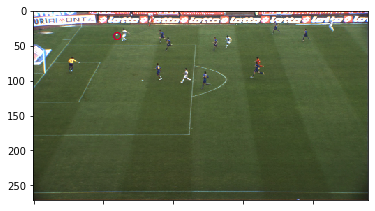

[ 36. 120.] [ 36. 116.] 0.99999905


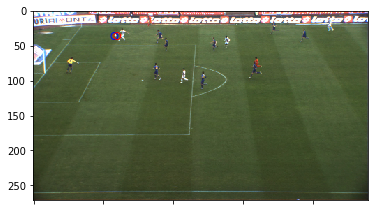

[ 36. 116.] [ 36. 116.] 0.9999714


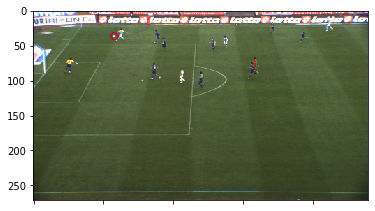

[ 40. 116.] [ 40. 116.] 0.9999924


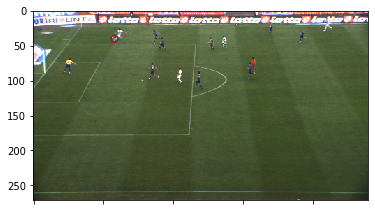

[ 40. 112.] [ 40. 112.] 1.0


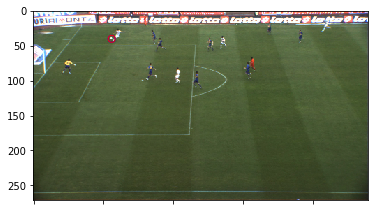

[ 40. 108.] [ 44. 108.] 0.9999933


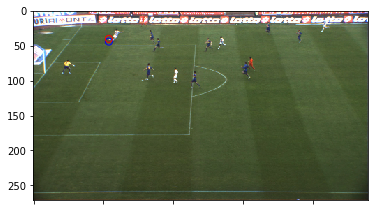

[ 40. 108.] [ 44. 108.] 0.99994755


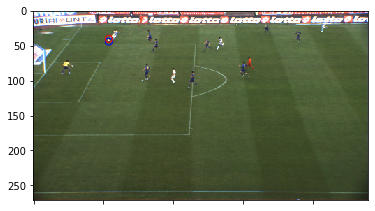

[ 40. 104.] [ 44. 108.] 1.0


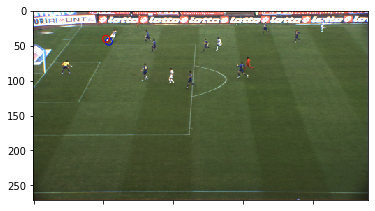

[ 44. 108.] [ 44. 108.] 0.99980927


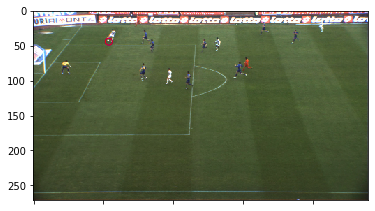

[88. 40.] [ 44. 108.] 0.99858147


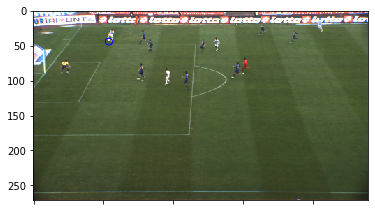

[88. 40.] [ 44. 112.] 0.99450576


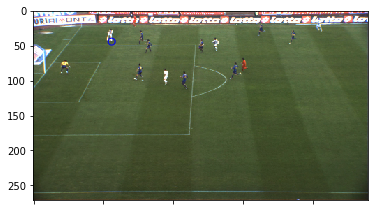

[ 92. 216.] [0. 0.] 0.9975497


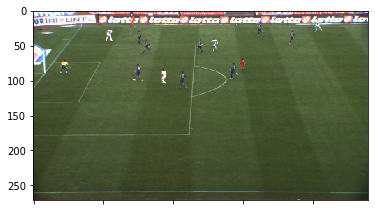

[ 52. 260.] [ 44. 112.] 0.99709505


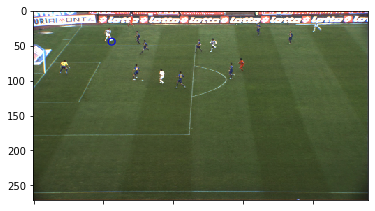

[ 12. 136.] [ 44. 116.] 0.999877


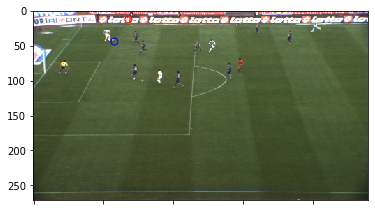

[ 44. 116.] [ 44. 116.] 0.9996267


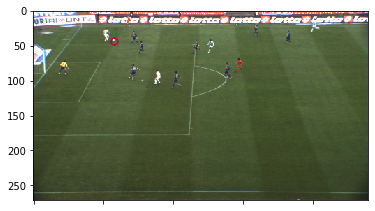

[ 44. 116.] [ 44. 116.] 0.9999809


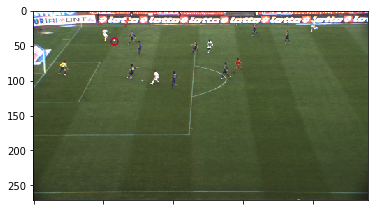

[ 44. 120.] [ 44. 120.] 1.0


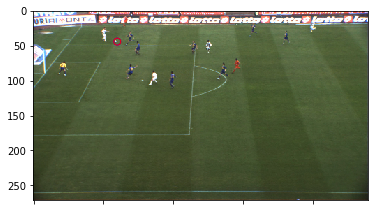

[ 44. 120.] [ 48. 120.] 0.9999961


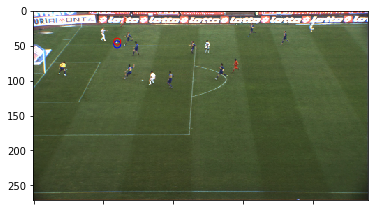

[ 48. 120.] [ 48. 120.] 1.0


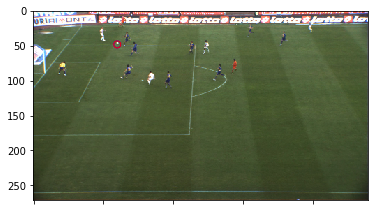

[ 48. 124.] [ 48. 124.] 1.0


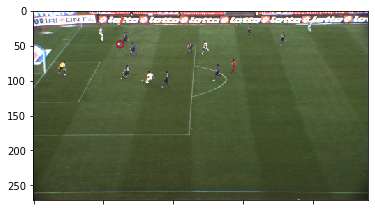

[ 48. 124.] [ 52. 124.] 1.0


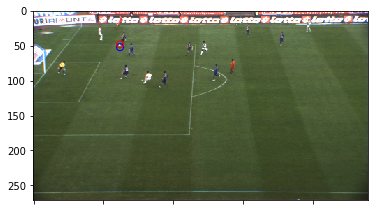

[ 52. 124.] [ 52. 128.] 0.9999933


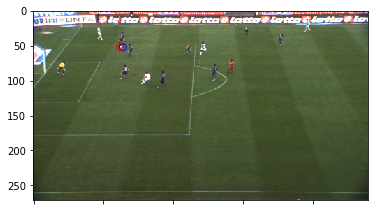

[92. 40.] [ 56. 128.] 0.99998665


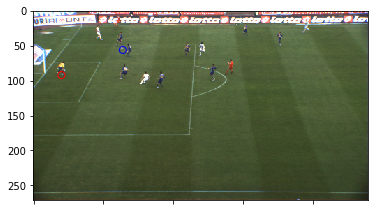

[ 56. 128.] [ 56. 128.] 0.99997324


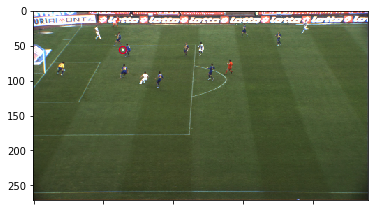

[ 60. 132.] [ 60. 132.] 0.9999161


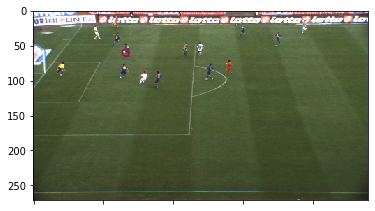

[ 60. 132.] [ 64. 132.] 0.9998103


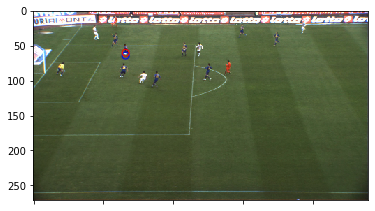

[ 24. 384.] [ 64. 132.] 0.9994961


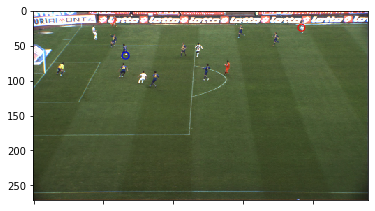

[104. 148.] [ 64. 136.] 0.99743026


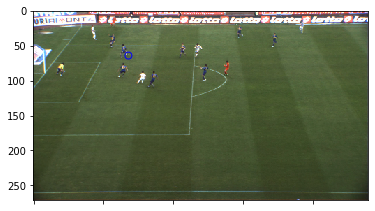

[104. 148.] [0. 0.] 0.99998856


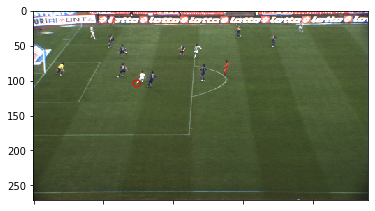

[104. 148.] [0. 0.] 0.99994177


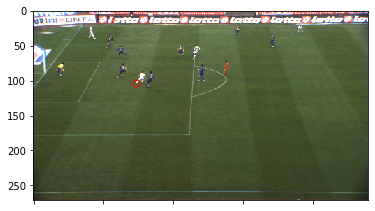

[ 60. 232.] [ 56. 128.] 0.99999714


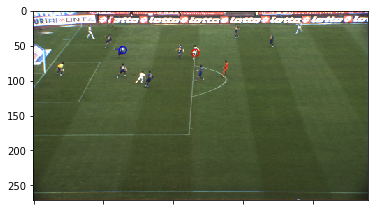

[100. 148.] [ 52. 128.] 0.99991226


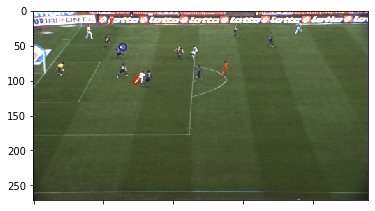

[100. 148.] [ 52. 124.] 1.0


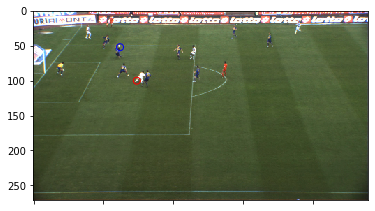

[ 48. 120.] [ 48. 120.] 0.9999961


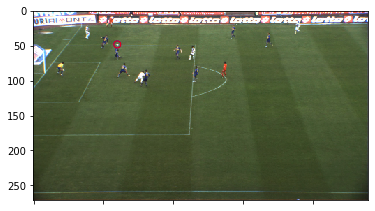

[ 48. 120.] [ 48. 120.] 0.99999803


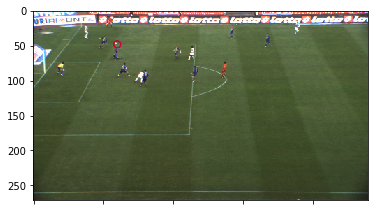

[ 44. 116.] [ 48. 116.] 1.0


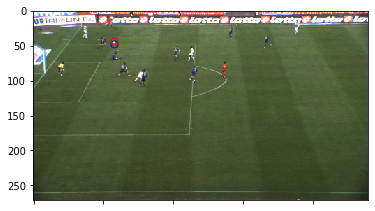

[ 44. 112.] [ 44. 112.] 1.0


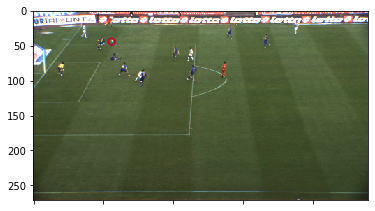

[ 44. 112.] [ 44. 112.] 0.99993706


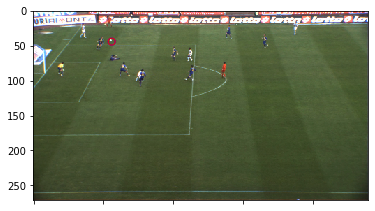

[ 40. 108.] [ 44. 108.] 1.0


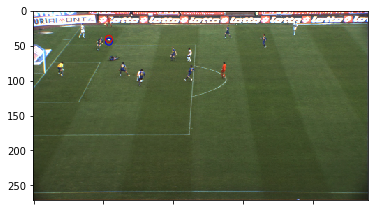

[ 40. 108.] [ 40. 108.] 0.99998564


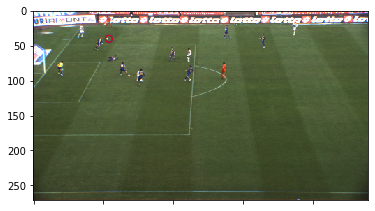

[ 40. 104.] [ 40. 104.] 0.99999714


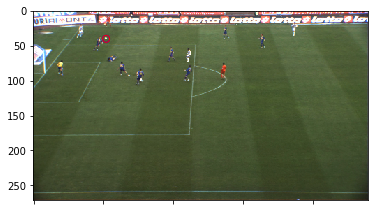

[ 40. 100.] [ 40. 104.] 0.9999132


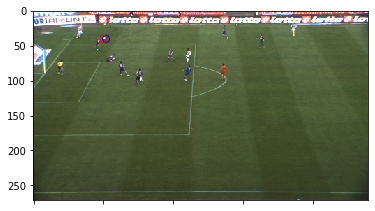

[ 96. 156.] [ 40. 100.] 0.9999571


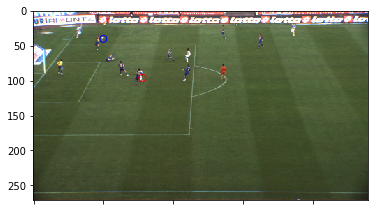

[92. 40.] [40. 96.] 0.99970347


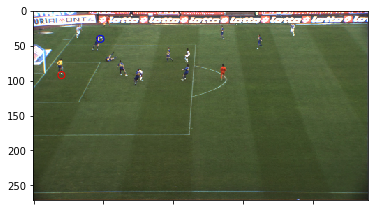

[92. 40.] [40. 96.] 0.9982863


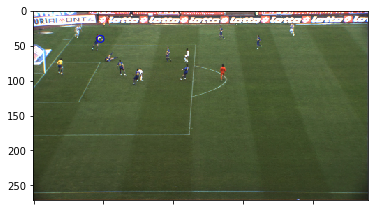

[100. 156.] [40. 96.] 0.9934498


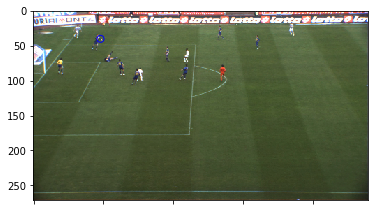

[ 96. 156.] [36. 96.] 0.9975877


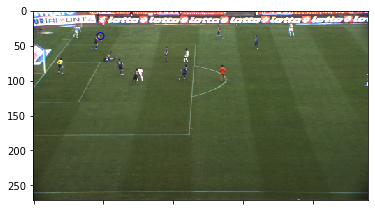

[100. 148.] [40. 96.] 0.99157846


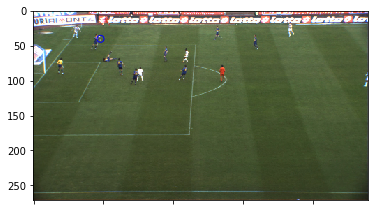

[ 76. 216.] [36. 96.] 0.9968526


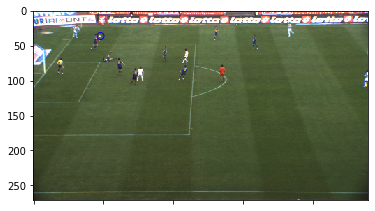

[36. 96.] [40. 96.] 0.99556196


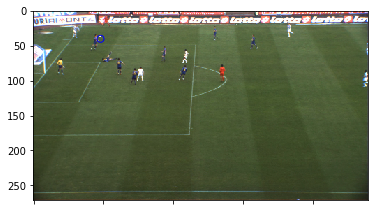

[ 32. 368.] [40. 96.] 0.9925009


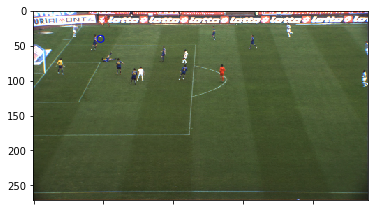

[36. 96.] [40. 96.] 0.9979845


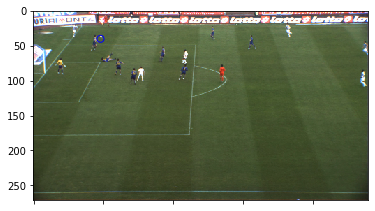

[76. 32.] [40. 96.] 0.9998741


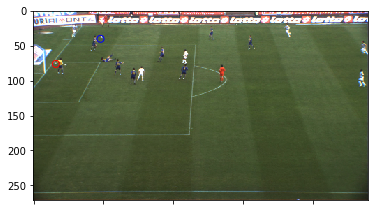

[72. 32.] [ 40. 100.] 0.99964577


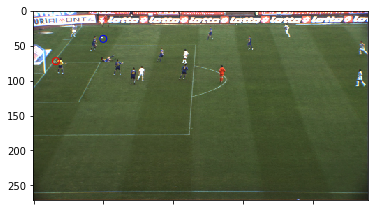

[ 40. 100.] [ 40. 100.] 0.9994227


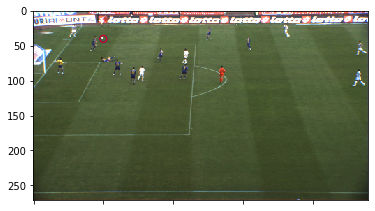

[ 40. 100.] [ 40. 100.] 0.99999046


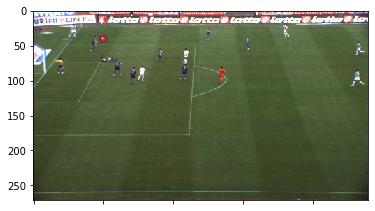

[ 40. 100.] [ 40. 100.] 0.99999046


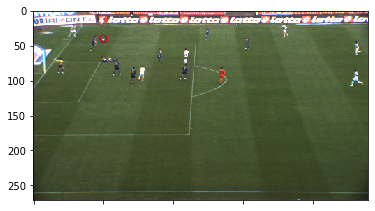

[ 44. 100.] [ 44. 100.] 0.9999933


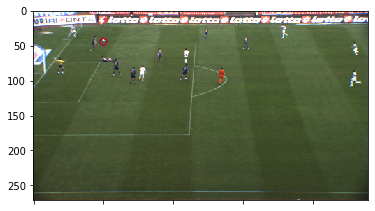

[ 44. 100.] [ 44. 104.] 1.0


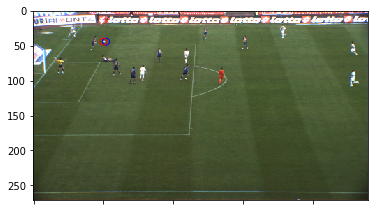

[ 44. 104.] [ 48. 104.] 0.99996084


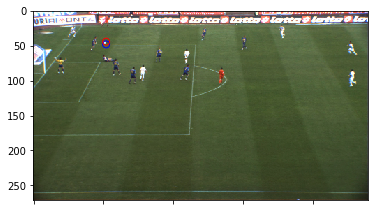

[ 48. 104.] [ 48. 104.] 0.9998026


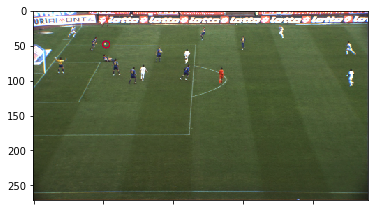

[ 48. 104.] [ 52. 104.] 0.9999924


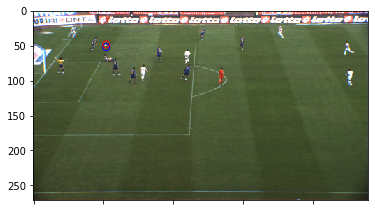

[ 52. 104.] [ 52. 104.] 0.9999676


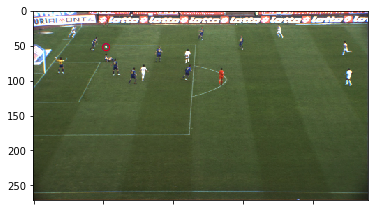

[ 56. 104.] [ 56. 104.] 0.9999837


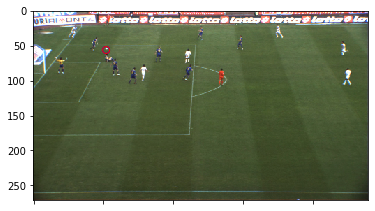

[ 56. 104.] [ 56. 104.] 1.0


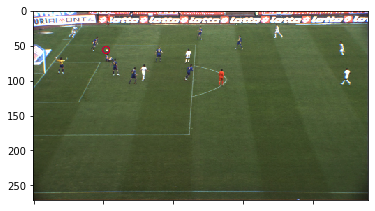

[ 56. 104.] [ 56. 108.] 1.0


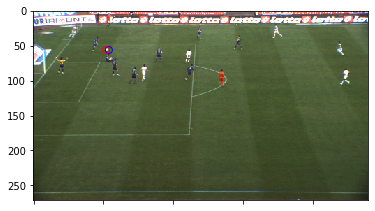

[ 56. 104.] [ 56. 108.] 0.9998951


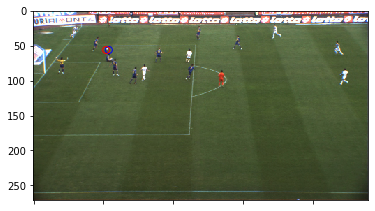

[ 52. 104.] [ 56. 104.] 0.99999905


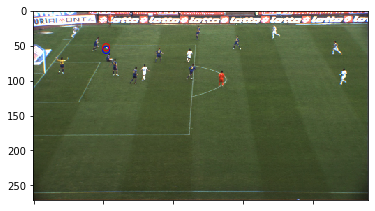

[ 52. 108.] [ 52. 108.] 0.99998856


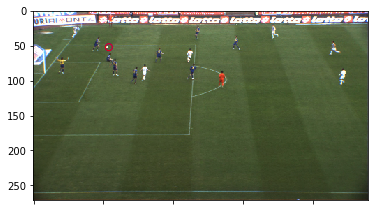

[ 52. 104.] [ 52. 108.] 1.0


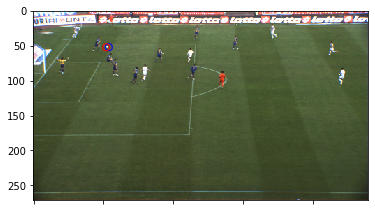

[ 52. 104.] [ 52. 108.] 1.0


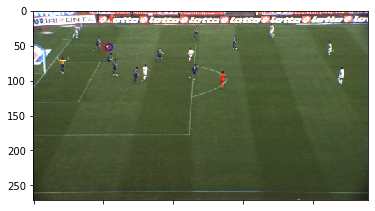

[ 52. 108.] [ 52. 108.] 0.99997234


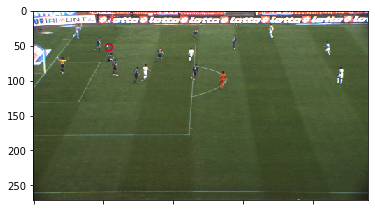

[ 52. 108.] [ 52. 108.] 0.9999552


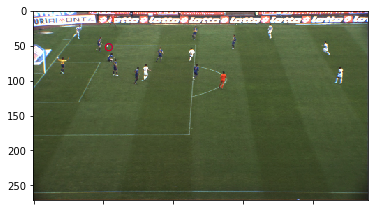

[ 52. 108.] [ 52. 108.] 0.9999685


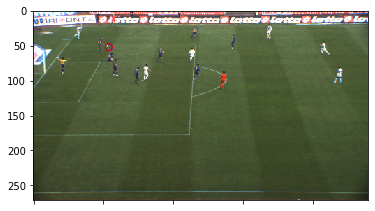

[ 52. 108.] [ 52. 108.] 0.9999676


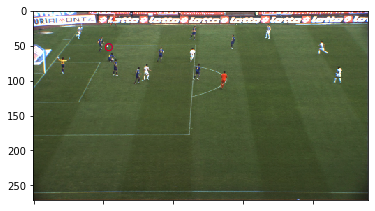

[ 52. 108.] [ 52. 108.] 0.99997044


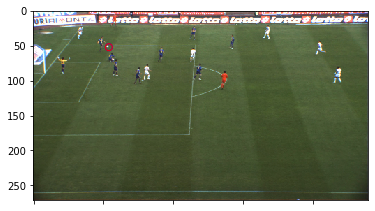

[ 40. 328.] [ 52. 108.] 0.99999714


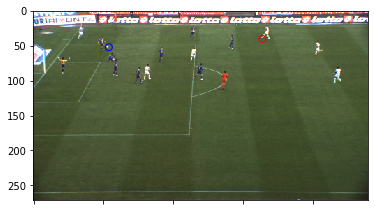

[ 40. 328.] [ 52. 108.] 0.9997921


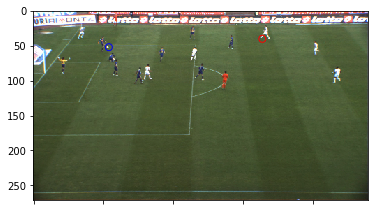

[ 52. 108.] [ 52. 108.] 0.99997807


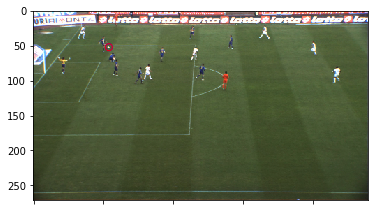

[ 52. 108.] [ 52. 112.] 0.9994084


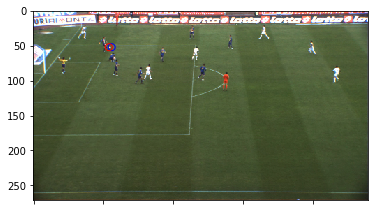

[ 52. 112.] [ 56. 112.] 0.9994256


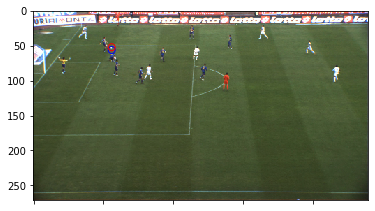

[ 56. 112.] [ 56. 112.] 0.99678123


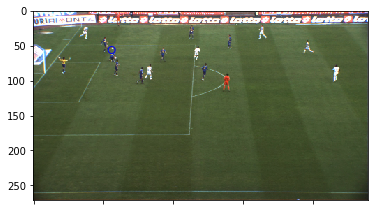

[ 56. 116.] [ 56. 116.] 0.9999037


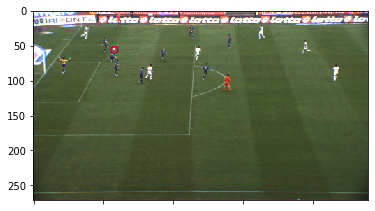

[ 56. 116.] [ 56. 116.] 0.99852


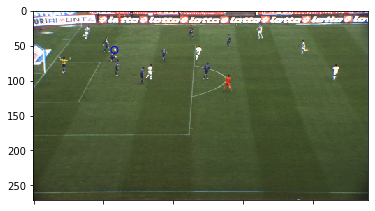

[ 56. 120.] [ 60. 120.] 0.99998


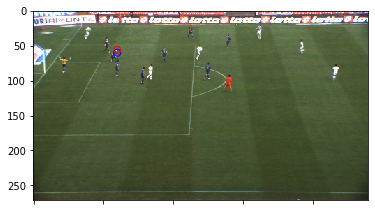

[ 60. 120.] [ 60. 120.] 0.99997044


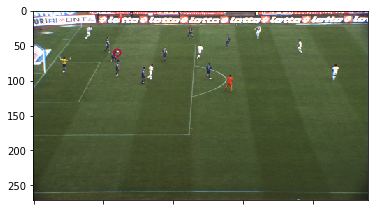

[ 60. 120.] [ 60. 124.] 0.9995695


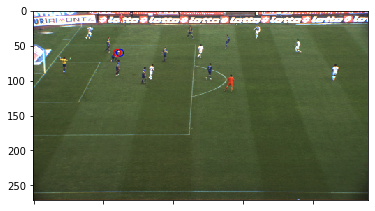

[ 56. 124.] [ 60. 124.] 0.9999543


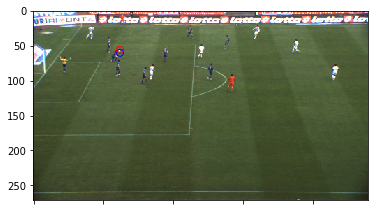

[ 56. 124.] [ 56. 124.] 0.99996185


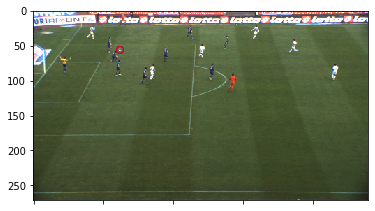

[ 56. 124.] [ 56. 124.] 0.99980354


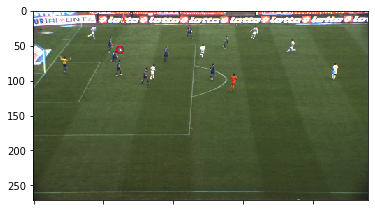

[ 56. 124.] [ 56. 124.] 0.99982935


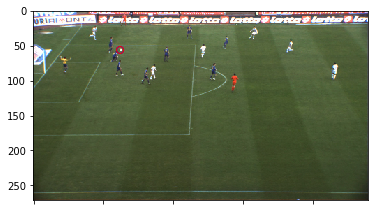

[ 40. 308.] [ 56. 128.] 0.99982077


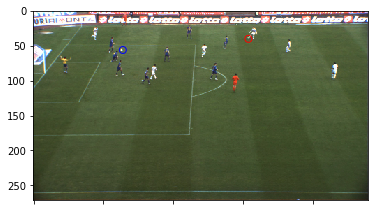

[ 40. 308.] [ 56. 128.] 0.99997234


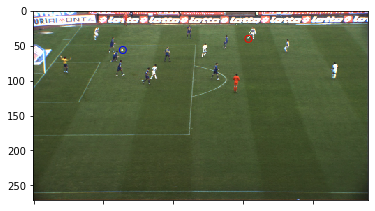

[ 40. 308.] [ 56. 128.] 0.9997645


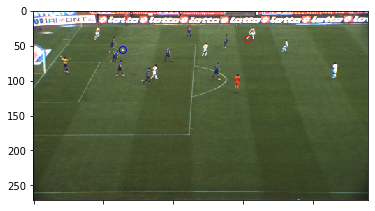

[ 56. 128.] [ 56. 128.] 0.9997664


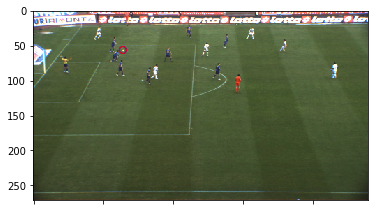

[ 60. 132.] [ 60. 132.] 0.9999104


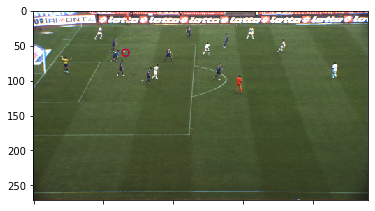

[ 60. 132.] [ 60. 132.] 0.9999924


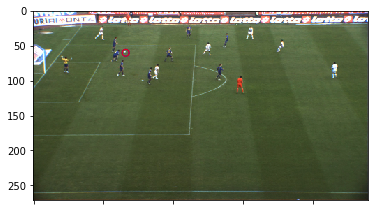

[ 60. 132.] [ 60. 132.] 0.99999905


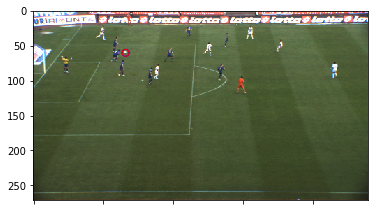

[ 60. 132.] [ 60. 132.] 0.999918


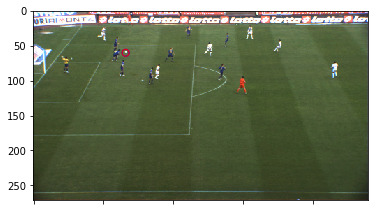

[ 60. 132.] [ 60. 132.] 0.9998932


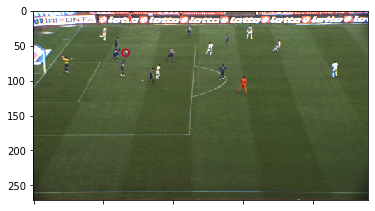

[ 60. 136.] [ 60. 136.] 0.999918


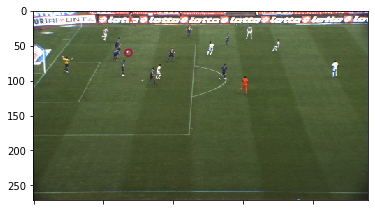

[ 60. 136.] [ 60. 136.] 0.99999905


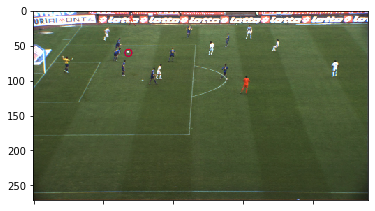

[ 60. 136.] [ 60. 136.] 0.9999791


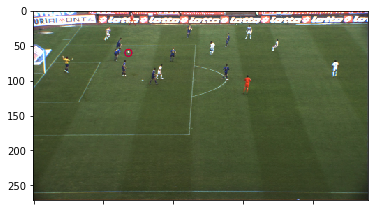

[ 60. 136.] [ 60. 136.] 0.99995327


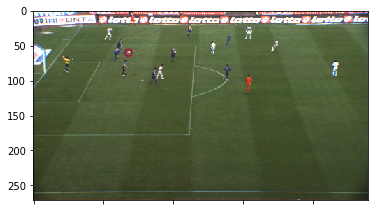

[ 60. 140.] [ 60. 140.] 0.99999046


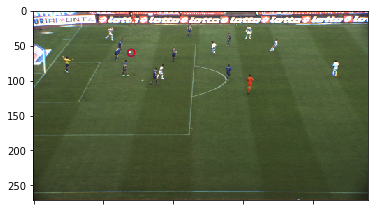

[ 60. 140.] [ 60. 140.] 0.99996275


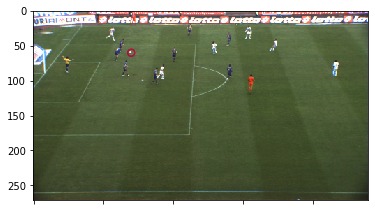

[ 60. 140.] [ 60. 140.] 0.99999523


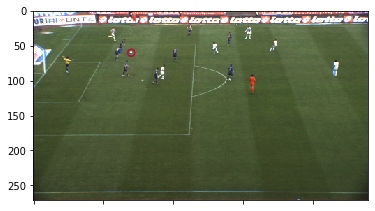

[ 60. 140.] [ 60. 140.] 0.9998703


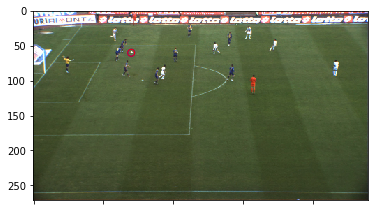

[ 60. 140.] [ 60. 144.] 0.99993706


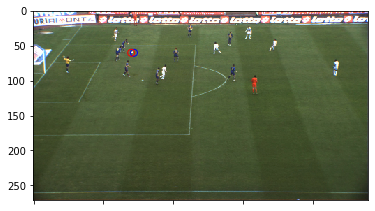

[ 60. 144.] [ 60. 144.] 0.9997673


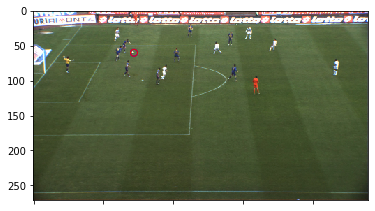

[ 60. 144.] [ 60. 144.] 0.9998751


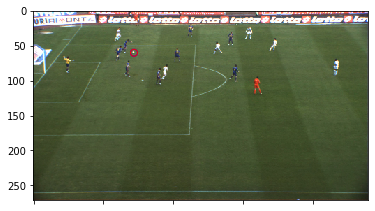

[ 60. 144.] [ 60. 144.] 0.9996506


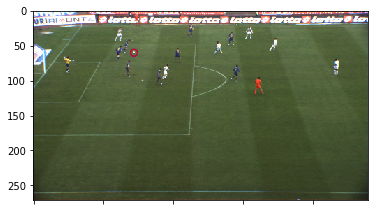

[ 60. 144.] [ 60. 144.] 0.9998684


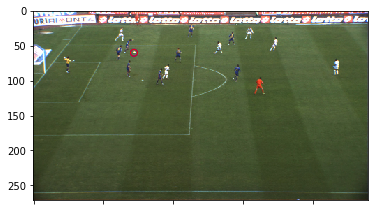

[ 60. 148.] [ 60. 148.] 0.99994755


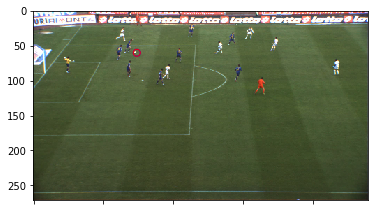

[ 40. 304.] [ 60. 148.] 0.99956566


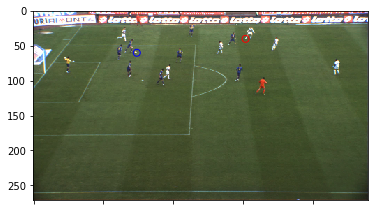

[ 60. 148.] [ 60. 148.] 0.9998722


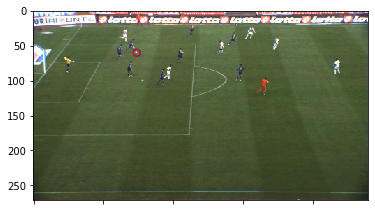

[ 40. 304.] [ 60. 148.] 0.9985705


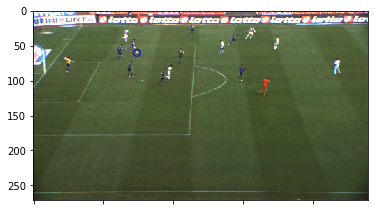

[  8. 140.] [ 60. 152.] 0.99778754


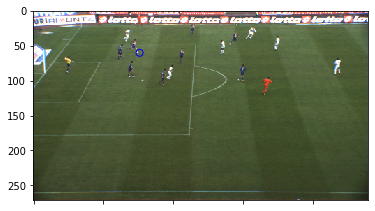

[ 40. 308.] [ 60. 152.] 0.99959284


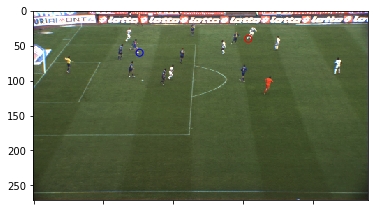

[ 60. 152.] [ 60. 152.] 0.9993484


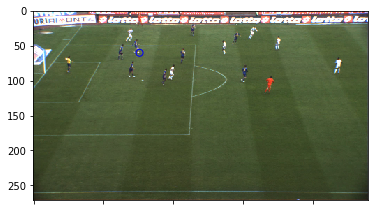

[  8. 140.] [ 60. 156.] 0.99853146


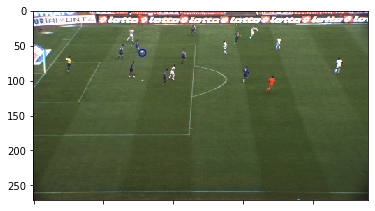

[ 52. 180.] [ 56. 168.] 0.99967384


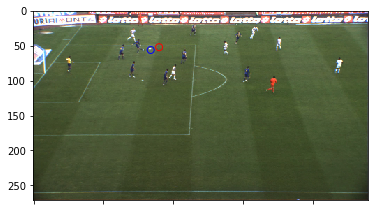

[ 52. 180.] [ 52. 180.] 0.99998283


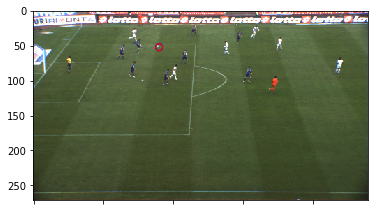

[ 48. 188.] [ 48. 188.] 1.0


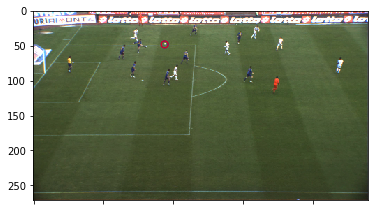

[ 44. 200.] [ 44. 200.] 1.0


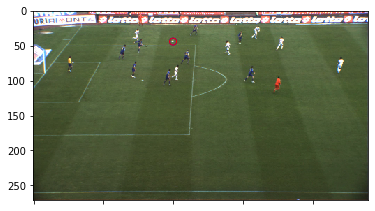

[ 40. 212.] [ 40. 212.] 0.9999924


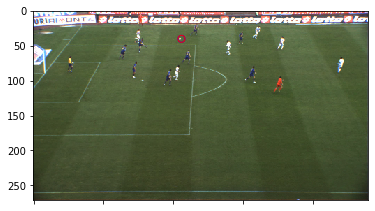

[ 36. 220.] [ 36. 220.] 0.9999961


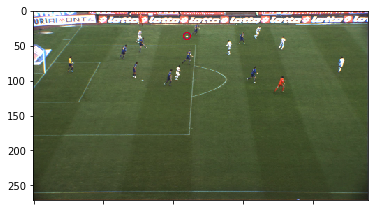

[ 32. 228.] [ 32. 232.] 0.99981886


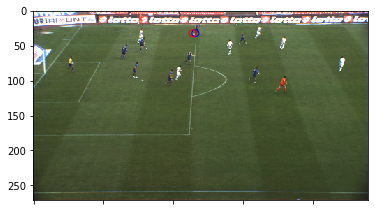

[ 32. 240.] [ 32. 240.] 0.9997397


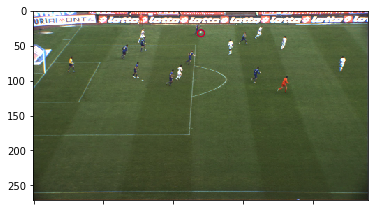

[ 28. 248.] [ 28. 252.] 1.0


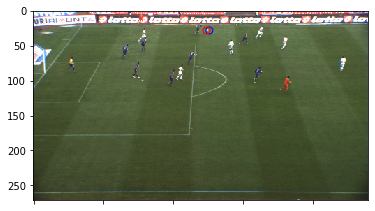

[ 24. 260.] [ 24. 260.] 0.9999132


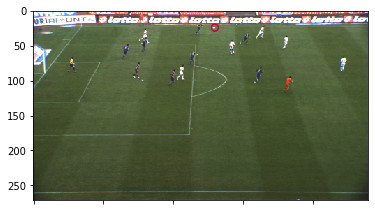

[ 24. 268.] [ 24. 268.] 0.99984455


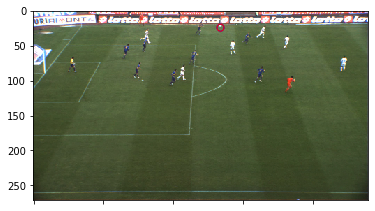

[ 20. 276.] [ 20. 276.] 0.9999085


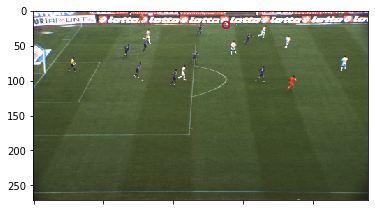

[  8. 140.] [ 12. 300.] 0.97148824


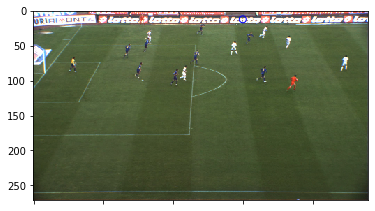

[  8. 140.] [ 16. 296.] 0.94576883


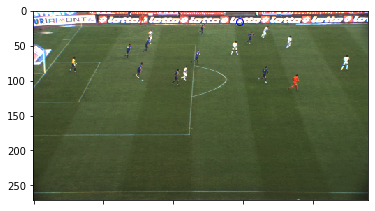

[  0. 344.] [ 12. 304.] 0.95748967


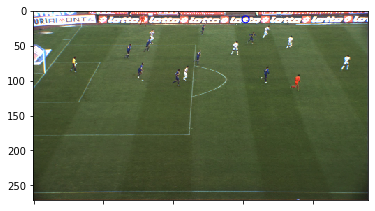

[  8. 312.] [ 12. 312.] 0.99994755


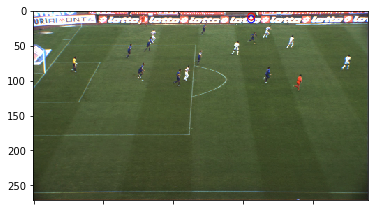

[  8. 320.] [  8. 320.] 0.99999803


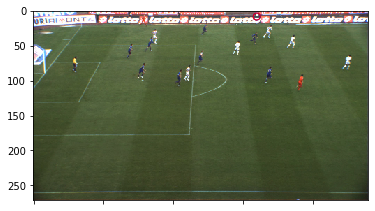

[ 36. 332.] [  4. 328.] 0.996719


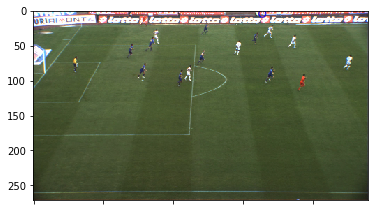

[  4. 336.] [  4. 336.] 0.9930538


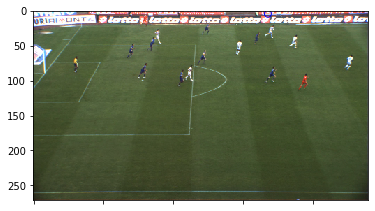

[  0. 344.] [  0. 344.] 0.9907476


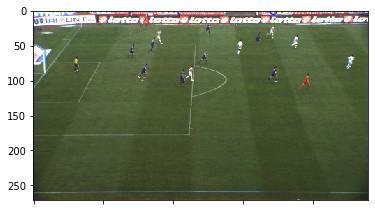

[ 32. 180.] [0. 0.] 0.9911908


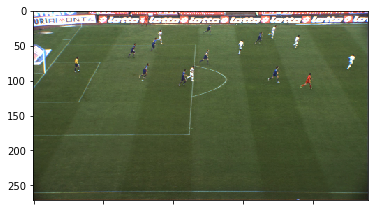

[ 20. 188.] [0. 0.] 0.9821445


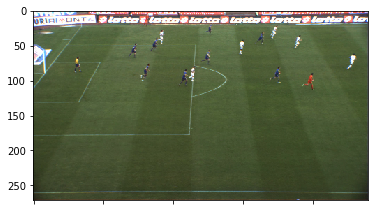

[ 32. 188.] [0. 0.] 0.9961037


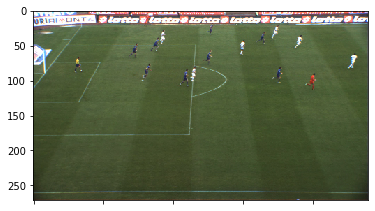

[ 32. 188.] [0. 0.] 0.9991373


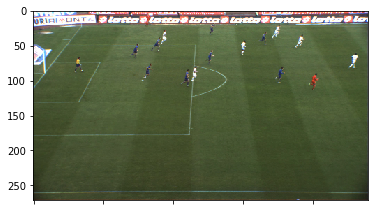

[ 32. 188.] [0. 0.] 0.99409133


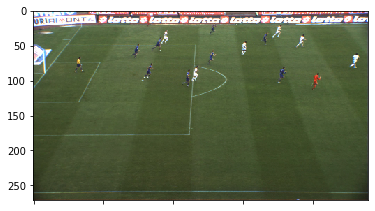

[  0. 344.] [0. 0.] 0.9828355


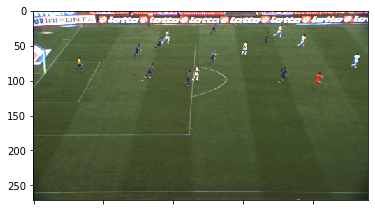

[ 32. 192.] [0. 0.] 0.9974189


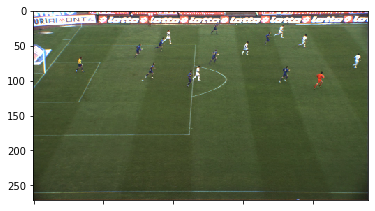

[ 24. 356.] [0. 0.] 0.9957072


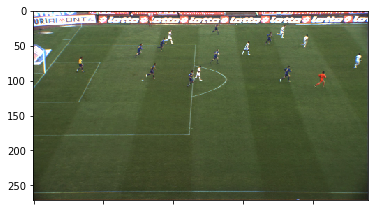

[ 32. 196.] [0. 0.] 0.9952221


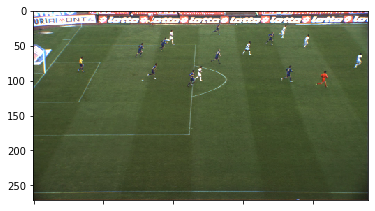

[ 96. 360.] [0. 0.] 0.9916565


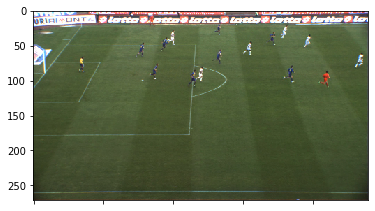

[ 24. 364.] [0. 0.] 0.98480815


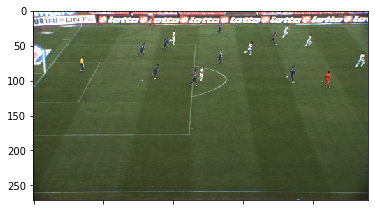

[ 24. 364.] [0. 0.] 0.9719168


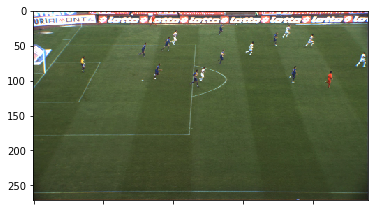

[  0. 376.] [0. 0.] 0.9632386


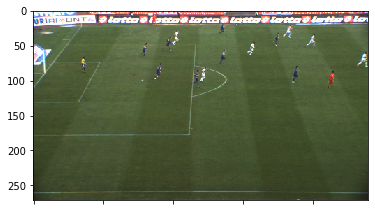

[ 48. 396.] [0. 0.] 0.98350734


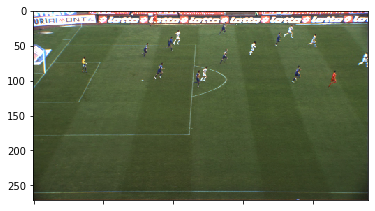

[ 48. 400.] [0. 0.] 0.9835955


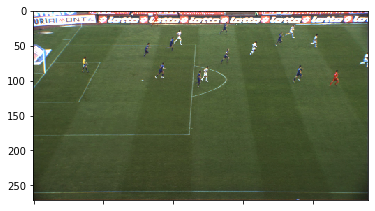

[ 44. 204.] [0. 0.] 0.99223447


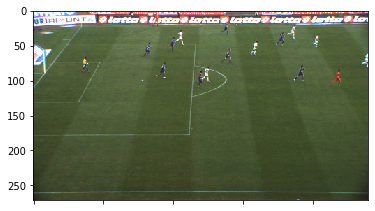

[  0. 372.] [0. 0.] 0.8325138


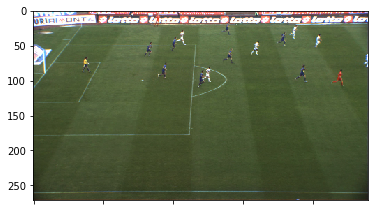

[ 44. 212.] [0. 0.] 0.9902257


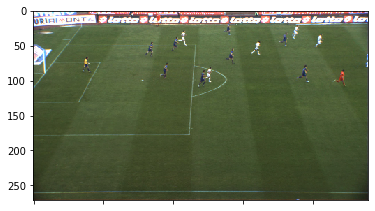

[ 24. 380.] [0. 0.] 0.98194635


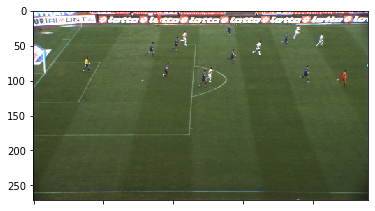

[ 36. 416.] [0. 0.] 0.9889055


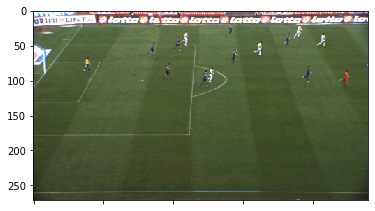

[ 36. 416.] [0. 0.] 0.98187196


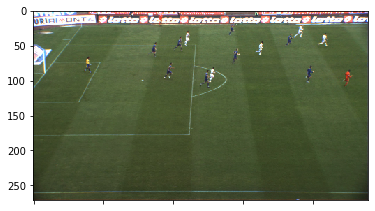

[ 24. 384.] [0. 0.] 0.9953644


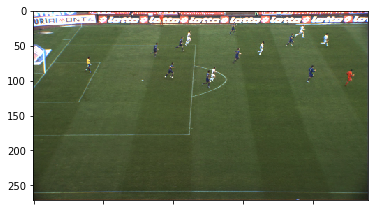

[ 36. 420.] [0. 0.] 0.93870556


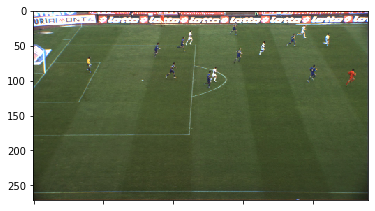

[ 24. 388.] [0. 0.] 0.98410124


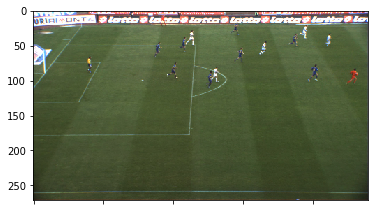

[ 96. 396.] [0. 0.] 0.9926244


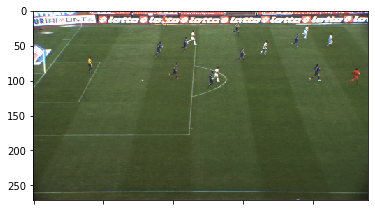

[ 20. 188.] [0. 0.] 0.9991264


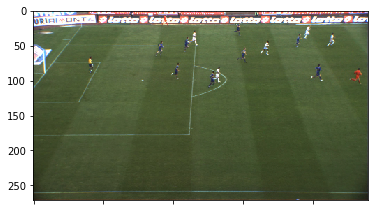

[ 60. 328.] [0. 0.] 0.9970998


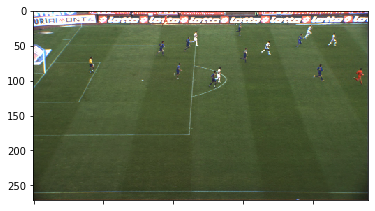

[ 48. 424.] [0. 0.] 0.9833146


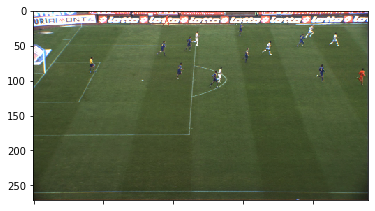

[ 56. 332.] [0. 0.] 0.99927735


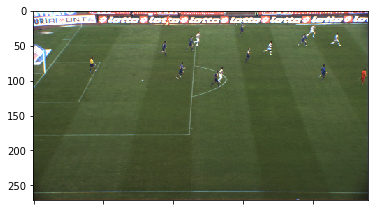

[ 36. 436.] [0. 0.] 0.92218214


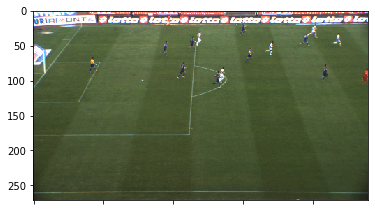

[ 20. 196.] [0. 0.] 0.90307754


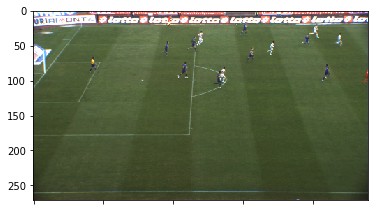

[ 32. 400.] [0. 0.] 0.98536384


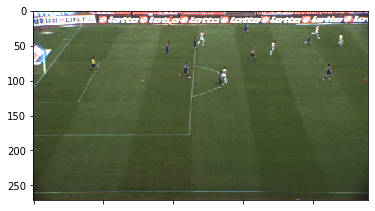

[ 96. 224.] [0. 0.] 0.9801199


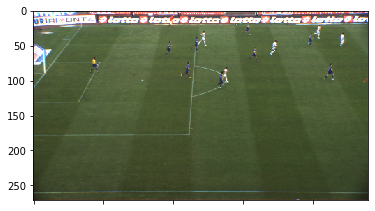

[  4. 268.] [0. 0.] 0.81057036


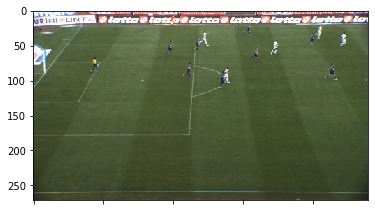

[ 48. 252.] [0. 0.] 0.96805453


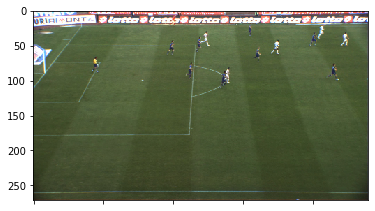

[ 24. 416.] [0. 0.] 0.92010653


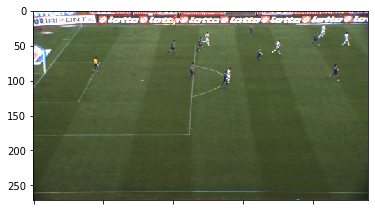

[ 60. 344.] [0. 0.] 0.86626846


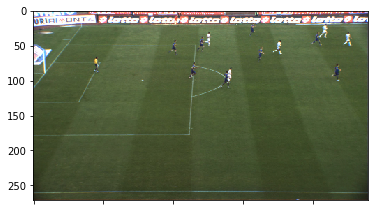

[ 24. 420.] [0. 0.] 0.97367364


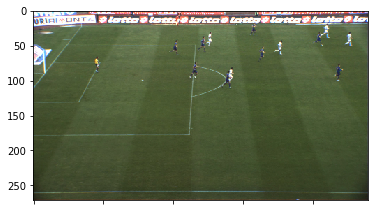

[ 24. 420.] [0. 0.] 0.9870187


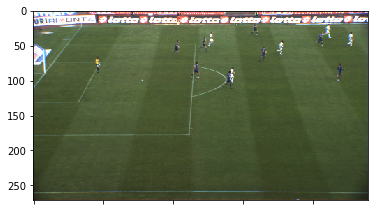

[  4. 268.] [0. 0.] 0.88342315


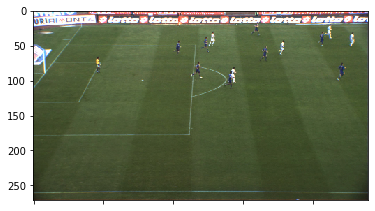

[  4. 268.] [0. 0.] 0.8767983


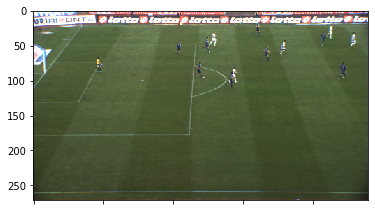

[ 32. 428.] [0. 0.] 0.9395371


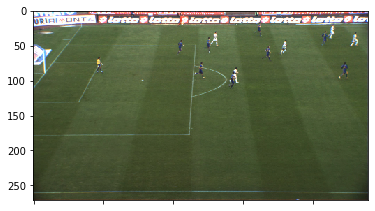

[ 48. 456.] [0. 0.] 0.9903121


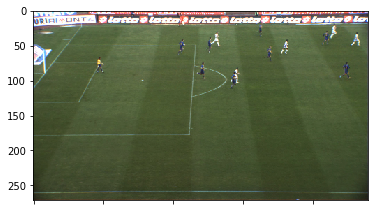

[ 92. 444.] [0. 0.] 0.98225176


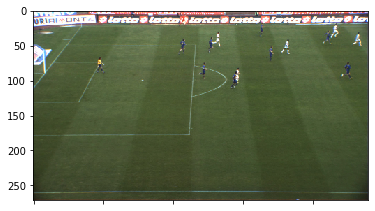

[ 88. 292.] [0. 0.] 0.9882116


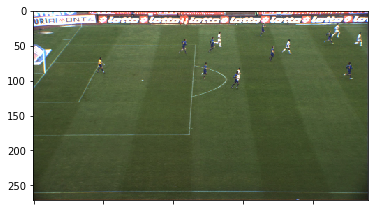

[  0. 344.] [0. 0.] 0.8460065


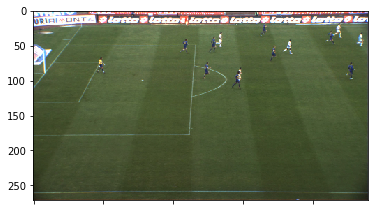

[  0. 460.] [0. 0.] 0.90438676


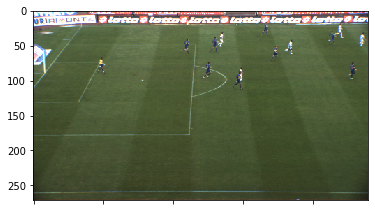

[ 84. 300.] [0. 0.] 0.9876576


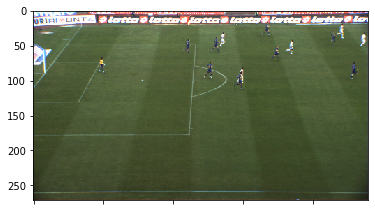

[ 84. 300.] [0. 0.] 0.9786246


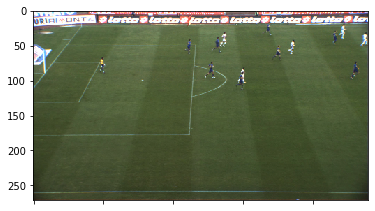

[  0. 460.] [0. 0.] 0.9526475


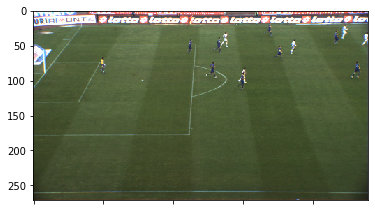

[ 92. 252.] [0. 0.] 0.9870309


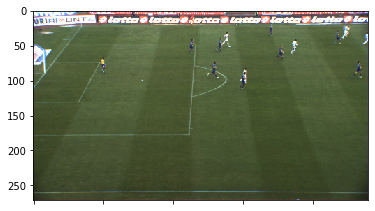

[  0. 460.] [0. 0.] 0.9554125


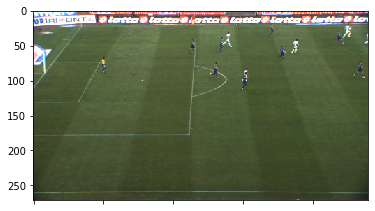

[ 88. 308.] [0. 0.] 0.9882577


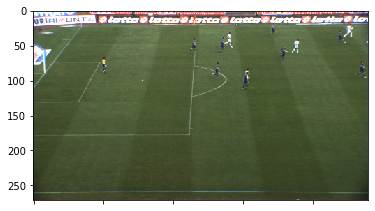

[  0. 460.] [0. 0.] 0.98605055


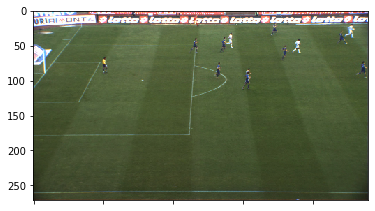

[  0. 460.] [0. 0.] 0.98994195


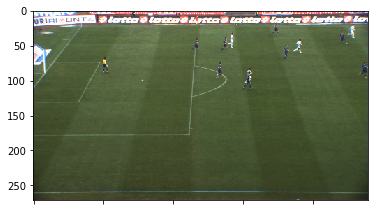

[100. 308.] [0. 0.] 0.9956037


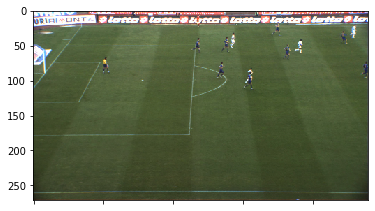

[  0. 460.] [0. 0.] 0.98135525


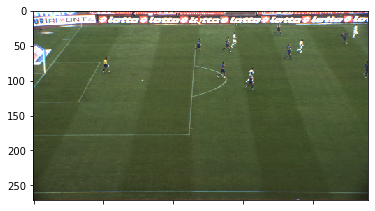

[ 88. 316.] [0. 0.] 0.97501564


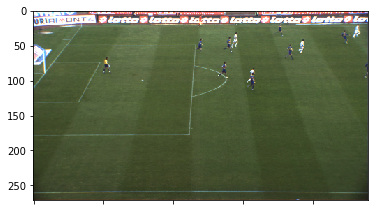

[ 88. 316.] [0. 0.] 0.99829966


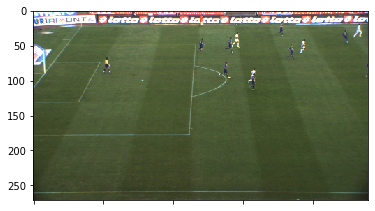

[  0. 460.] [0. 0.] 0.93015796


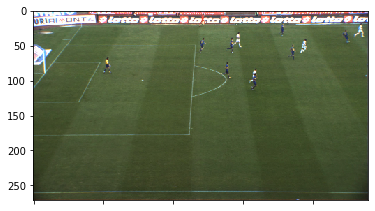

[ 52. 300.] [0. 0.] 0.9554326


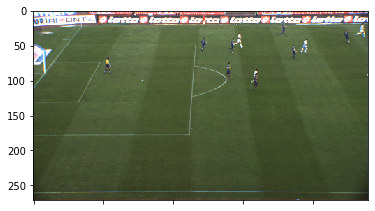

[ 88. 320.] [0. 0.] 0.9798823


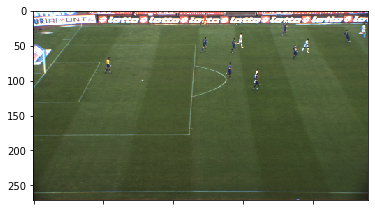

[ 36. 300.] [0. 0.] 0.97576237


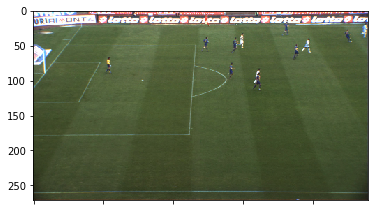

[ 84. 324.] [0. 0.] 0.9768271


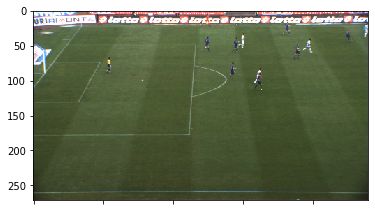

[  0. 140.] [0. 0.] 0.85533136


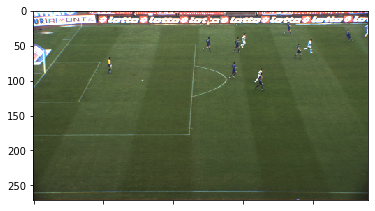

In [0]:
Cin = 9
from matplotlib.patches import Circle
DeepBallmodel = DeepBallMF(Cin).to(device)
DeepBallmodel.load_state_dict(torch.load(folderpath+'DeepBallmodelMF.pt')) #load the last checkpoint
import matplotlib.animation as animation
A = []
staridx = 400
Nimg = 300

for idx in range(Nimg):
  index = idx+staridx
  with torch.no_grad():
    DeepBallmodel.eval()
    img, label =  test_dataset[index]
    # img, label = iter(dataloader).next()
    img = (img.view(1,Cin,272,480)).to(device)
    img1 = img[0][3:6]
    Mask= DeepBallmodel(img.float()/255.0)
    Mask = torch.exp(Mask)
  a = (Mask[0][0].cpu().numpy())
  pos = np.unravel_index(np.argmax(a), a.shape)
  pos = np.array(pos,dtype=np.float16)*4
  real_pos = np.array(np.unravel_index(np.argmax(label.cpu().numpy()), label.cpu().numpy().shape),dtype=np.float16)*4
  
  pm = a.max()
  print(pos, real_pos, pm)
  # print(label.size())
  fig = plt.figure()
  ax = fig.add_subplot(1, 1, 1)
  ax.set_xticklabels('')

  img1 = img1.to('cpu')
  img1 = img1.view(3,272,480)
    # plt.imshow(np.transpose(img.numpy(),(1,2,0)))
    # plt.imshow(label.cpu(),cmap='gray')
    # plt.subplot(2,2,2)
    # om = 1-torch.argmax(Mask.squeeze(), dim=0).detach().cpu().numpy()
  Mask = Mask.cpu()
  ax.imshow(np.transpose(img1.numpy(),(1,2,0)))
  if real_pos.sum()>0.001:
  
    c2 = Circle((real_pos[1],real_pos[0]), radius=5,
              edgecolor='blue', facecolor = 'None')
    ax.add_patch(c2)
  if pm > 0.9994:
    c1 = Circle((pos[1],pos[0]), radius=5,
              edgecolor='red', facecolor = 'None')
    ax.add_patch(c1)
  plt.show()
  fig.savefig(folderpath+'imagesForAvi/MFDeepBall'+str(index)+'.png')
# plt.subplot(2,2,3)
# plt.imshow(Mask[0][0], cmap='gray')
# plt.subplot(2,2,4)
# plt.imshow(Mask[0][1], cmap='gray')

Finding Theta

0.9404999999999999 0.43417975275643167
0.9409999999999998 0.4348479786167725
0.9414999999999998 0.43534914801202806
0.9419999999999997 0.43551620447711326
0.9424999999999997 0.4360173738723689
0.9429999999999996 0.4360173738723689
0.9434999999999996 0.43668559973270965
0.9439999999999995 0.4371867691279652
0.9444999999999995 0.43802205145339124
0.9449999999999994 0.43852322084864687
0.9454999999999993 0.4393585031740728
0.9459999999999993 0.43985967256932845
0.9464999999999992 0.4405278984296692
0.9469999999999992 0.4408620113598396
0.9474999999999991 0.4415302372201804
0.9479999999999991 0.4425325760106916
0.948499999999999 0.4442031406615436
0.948999999999999 0.44537253591714
0.9494999999999989 0.44704310056799196
0.9499999999999988 0.44787838289341797
0.9504999999999988 0.448713665218844
0.9509999999999987 0.44938189107918475
0.9514999999999987 0.45105245573003677
0.9519999999999986 0.4520547945205479
0.9524999999999986 0.45355830270631475
0.9529999999999985 0.4543935850317407
0.953

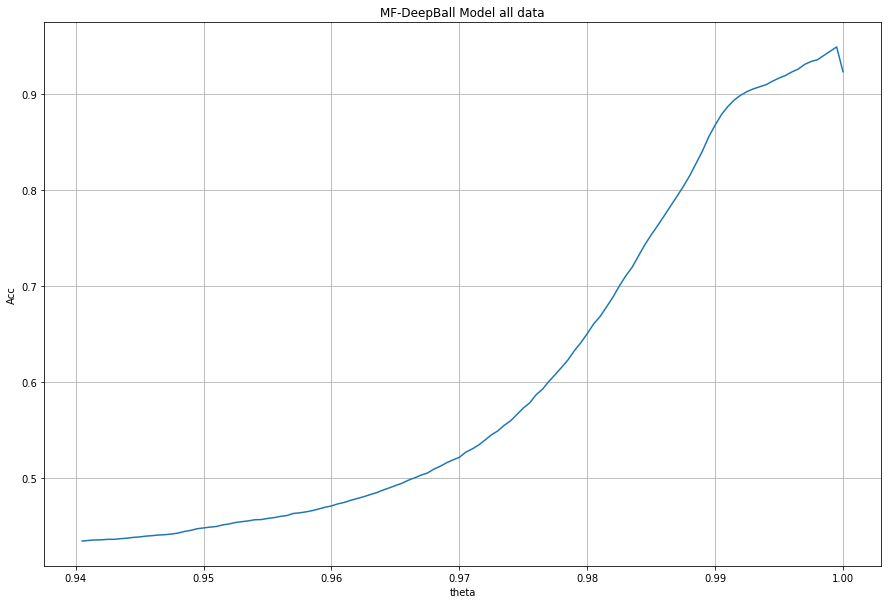

0.9994999999999934 0.9485466087537587
0.9404999999999999 0.42733043768793855
0.9409999999999998 0.42983628466421653
0.9414999999999998 0.43217507517540926
0.9419999999999997 0.4348479786167725
0.9424999999999997 0.43752088205813566
0.9429999999999996 0.44002672903441364
0.9434999999999996 0.4418643501503508
0.9439999999999995 0.443701971266288
0.9444999999999995 0.4455395923822252
0.9449999999999994 0.44704310056799196
0.9454999999999993 0.44921483461409956
0.9459999999999993 0.45155362512529235
0.9464999999999992 0.4553959238222519
0.9469999999999992 0.4582358837287003
0.9474999999999991 0.4597393919144671
0.9479999999999991 0.4614099565653191
0.948499999999999 0.46408286000668225
0.948999999999999 0.46508519879719346
0.9494999999999989 0.4679251587036418
0.9499999999999988 0.4699298362846642
0.9504999999999988 0.4712662880053458
0.9509999999999987 0.4732709655863682
0.9514999999999987 0.47527564316739057
0.9519999999999986 0.47778149014366855
0.9524999999999986 0.47895088539926495
0.

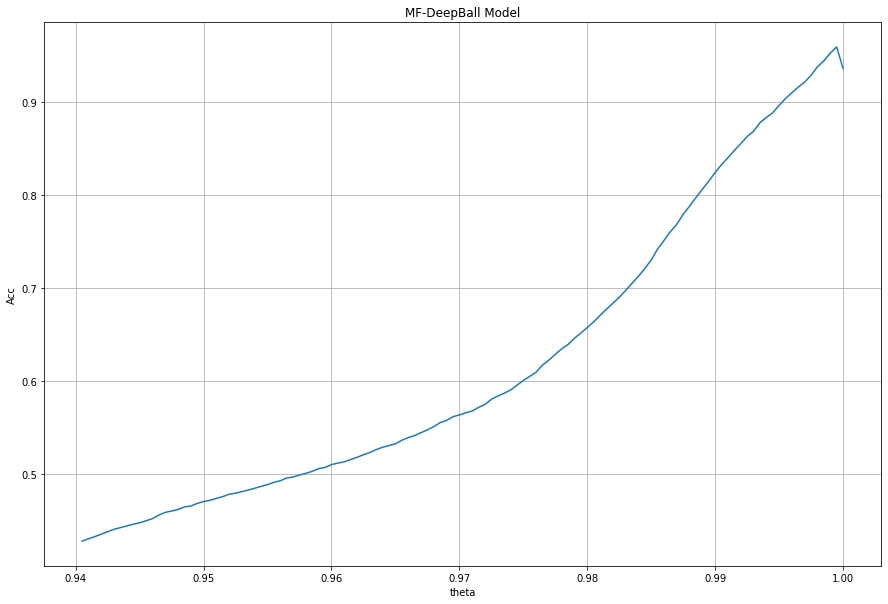

0.9994999999999934 0.9595723354493819


In [0]:
Cin = 9
DeepBallmodel = DeepBallMF(Cin).to(device)
DeepBallmodel.load_state_dict(torch.load(folderpath+'DeepBallmodelMFa.pt')) #load the last checkpoint
mAcc, th = evaluate(DeepBallmodel,test_dataset)
plt.title('MF-DeepBall Model all data')
plt.show()
print(mAcc, th)
Cin = 9
DeepBallmodel = DeepBallMF(Cin).to(device)
DeepBallmodel.load_state_dict(torch.load(folderpath+'DeepBallmodelMF.pt')) #load the last checkpoint
mAcc, th = evaluate(DeepBallmodel,test_dataset)
plt.title('MF-DeepBall Model')
plt.show()
print(mAcc, th)